# Liver Disease Patient Classification

The dataset consist with 10 features related to the liver disease biochemicalmarkers. 
<br><b> Objective : To predict whether a patient suffers from liver disease based on the several biochecmical markers</b>

The ten features as follows.


<ol>
    <li>Age of the patient</li>
<li>Gender of the patient</li>
<li>Total Bilirubin</li>
<li>Direct Bilirubin</li>
<li>Alkphos Alkaline Phosphotase</li>
<li>Sgpt Alamine Aminotransferase</li>
<li>Sgot Aspartate Aminotransferase</li>
<li>Total Protiens</li>
<li>ALB Albumin</li>
<li>A/G Ratio Albumin and Globulin Ratio</li>
<li>Results (Target variable) 1 - indicates Liver Patient, 2 - indicates non Liver Patient</li>
</ol>
<br>
The dataset can be accessible via https://www.kaggle.com/datasets/abhi8923shriv/liver-disease-patient-dataset/data

**Importing the Libraries and Dependencies**

In [1]:
#Install libraries
# pip install seaborn
# pip install pandas
# pip install numpy
# pip install scikit-learn
# pip install imblearn
# pip install scikeras
# pip install tensorflow

In [3]:
import seaborn as sns
import pandas as pd
import numpy as np
from numpy import std
from numpy import mean
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, roc_auc_score
import os
import itertools
import pickle
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import KFold, GridSearchCV
from scikeras.wrappers import KerasClassifier

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dropout
from tensorflow.keras.optimizers import Adam
import warnings

warnings.filterwarnings('ignore') 

# 1. Data Loading

In [4]:
# load the dataset into dataframe
def load_patient_data():
    return pd.read_csv(r"./LiverPatientDataset(LPD)train.csv",encoding='unicode_escape')

df = load_patient_data()
df.head()

,Age of the patient,Gender of the patient,Total Bilirubin,Direct Bilirubin,Alkphos Alkaline Phosphotase,Sgpt Alamine Aminotransferase,Sgot Aspartate Aminotransferase,Total Protiens,ALB Albumin,A/G Ratio Albumin and Globulin Ratio,Result
0,65.0,Female,0.7,0.1,187.0,16.0,18.0,6.8,3.3,0.90,1
1,62.0,Male,10.9,5.5,699.0,64.0,100.0,7.5,3.2,0.74,1
2,62.0,Male,7.3,4.1,490.0,60.0,68.0,7.0,3.3,0.89,1
3,58.0,Male,1.0,0.4,182.0,14.0,20.0,6.8,3.4,1.00,1
4,72.0,Male,3.9,2.0,195.0,27.0,59.0,7.3,2.4,0.40,1


In [6]:
#Print dataframe information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30691 entries, 0 to 30690
Data columns (total 11 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Age of the patient                    30689 non-null  float64
 1   Gender of the patient                 29789 non-null  object 
 2   Total Bilirubin                       30043 non-null  float64
 3   Direct Bilirubin                      30130 non-null  float64
 4    Alkphos Alkaline Phosphotase         29895 non-null  float64
 5    Sgpt Alamine Aminotransferase        30153 non-null  float64
 6   Sgot Aspartate Aminotransferase       30229 non-null  float64
 7   Total Protiens                        30228 non-null  float64
 8    ALB Albumin                          30197 non-null  float64
 9   A/G Ratio Albumin and Globulin Ratio  30132 non-null  float64
 10  Result                                30691 non-null  int64  
dtypes: float64(9), 

The dataset has 30691 entries. Also, the dataset has numerical and categorcial variables.

Observation: Some of the feature names has white spaces in the name. 
             Therefore, I am removing those spaces in the dataframe columns in the next cell.

In [7]:
#Modify the dataframe columns by removing white spaces in feature names.
df.columns = df.columns.str.strip()
df.columns

Index(['Age of the patient', 'Gender of the patient', 'Total Bilirubin',
       'Direct Bilirubin', 'Alkphos Alkaline Phosphotase',
       'Sgpt Alamine Aminotransferase', 'Sgot Aspartate Aminotransferase',
       'Total Protiens', 'ALB Albumin', 'A/G Ratio Albumin and Globulin Ratio',
       'Result'],
      dtype='object')

# 2. Exploratory Data Analysis and Data Pre-processing

In [8]:
#Showing statistical description of data
df.describe()

,Age of the patient,Total Bilirubin,Direct Bilirubin,Alkphos Alkaline Phosphotase,Sgpt Alamine Aminotransferase,Sgot Aspartate Aminotransferase,Total Protiens,ALB Albumin,A/G Ratio Albumin and Globulin Ratio,Result
count,30689.000000,30043.000000,30130.000000,29895.000000,30153.000000,30229.000000,30228.000000,30197.000000,30132.000000,30691.000000
mean,44.107205,3.370319,1.528042,289.075364,81.488641,111.469979,6.480237,3.130142,0.943467,1.285882
std,15.981043,6.255522,2.869592,238.537589,182.158850,280.851078,1.081980,0.792281,0.323164,0.451841
min,4.000000,0.400000,0.100000,63.000000,10.000000,10.000000,2.700000,0.900000,0.300000,1.000000
25%,32.000000,0.800000,0.200000,175.000000,23.000000,26.000000,5.800000,2.600000,0.700000,1.000000
50%,45.000000,1.000000,0.300000,209.000000,35.000000,42.000000,6.600000,3.100000,0.900000,1.000000
75%,55.000000,2.700000,1.300000,298.000000,62.000000,88.000000,7.200000,3.800000,1.100000,2.000000
max,90.000000,75.000000,19.700000,2110.000000,2000.000000,4929.000000,9.600000,5.500000,2.800000,2.000000


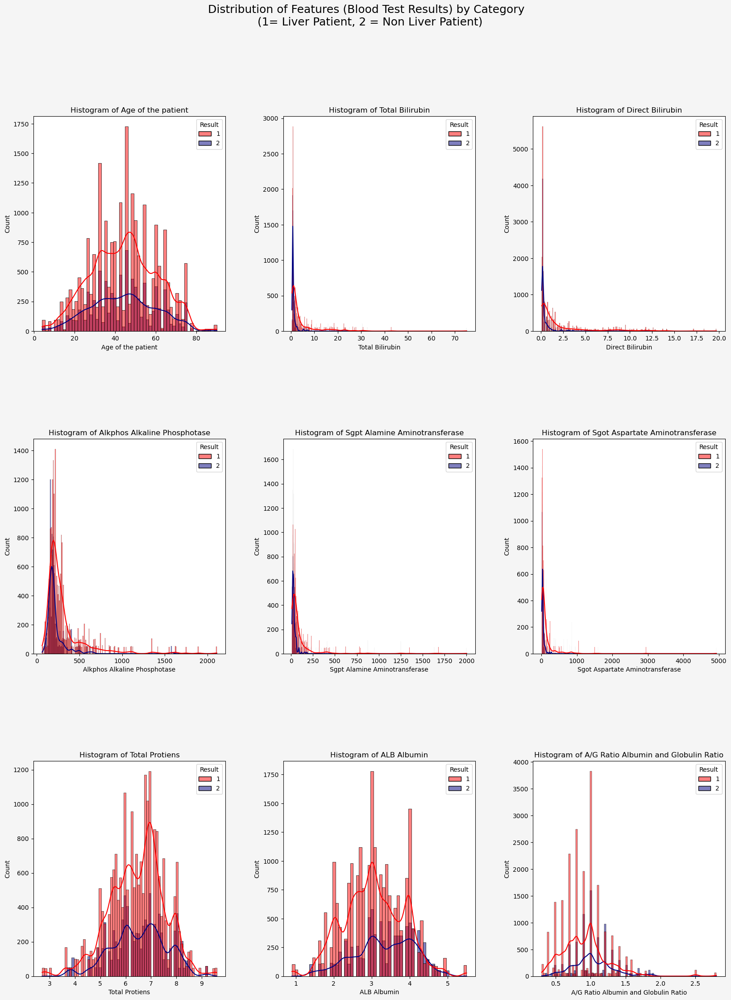

In [9]:
#set the figure and axes
fig, axes = plt.subplots(3, 3, figsize=(20, 25))
axes = axes.flatten()
fig.patch.set_facecolor('#f5f5f5')

# The columns to plot. Remove the target variable
newDf = df.drop(['Result','Gender of the patient'], axis=1)

# Plot a histogram for each feature
for index,column in enumerate(newDf.columns):
    sns.histplot(x=newDf[column], hue=df["Result"], ax=axes[index],kde=True, palette=['red', 'navy'])
    axes[index].set_title(f"Histogram of {column}")

#Figure Title
fig.suptitle("Distribution of Features (Blood Test Results) by Category \n (1= Liver Patient, 2 = Non Liver Patient)", fontsize=18)

# Set the spacing between subplots
plt.subplots_adjust(hspace=0.5, wspace=0.3)


**Checking for Outliers**

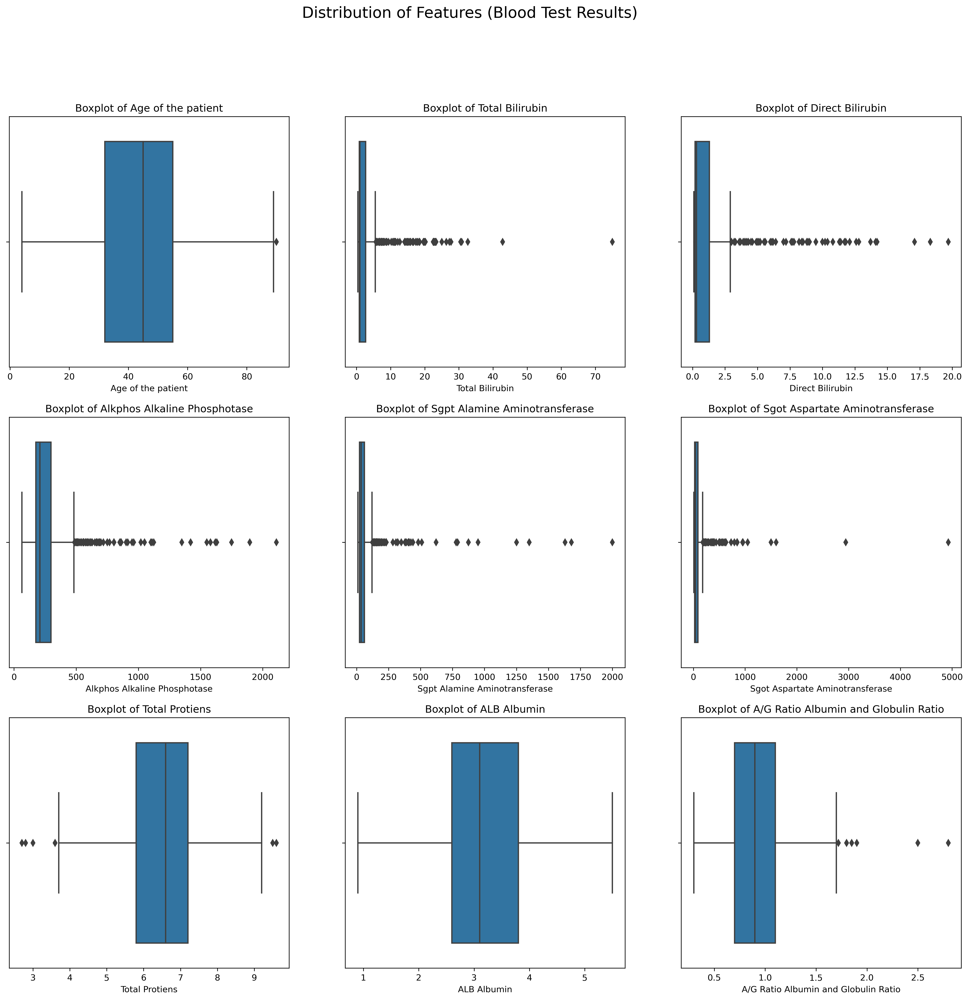

In [10]:
#set the figure and axes
plt.rcParams['figure.dpi'] = 300
fig, axes = plt.subplots(3, 3, figsize=(20, 18))
axes = axes.flatten()
#fig.patch.set_facecolor('#f5f5f5')

# The columns to plot. Remove the target variable
#newDf = df.drop('Result', axis=1)

# Plot a histogram for each feature
for index,column in enumerate(newDf.columns):
    sns.boxplot(x=newDf[column], ax=axes[index])
    axes[index].set_title(f"Boxplot of {column}")

#Figure Title
fig.suptitle("Distribution of Features (Blood Test Results)", fontsize=18)

# Set the spacing between subplots
plt.subplots_adjust(hspace=0.2, wspace=0.2)
plt.savefig('outlier-boxplot.png')

**Observation: Total bilirubin, Direct Bilirubin, Alkphos Alkaline Phosphotas, Sgpt Alamine Aminotransferase, Sgot Aspartate Aminotransferase, Total Protiens, and A/G Ratio Albumin and Globulin Ratio have outliers.**

**Experiment : Apply IQR Based Filtering for Outlier Removal**

IQR Based Filtering will be applied to some of the features as they show skewed distribution.

**Finding the IQR**

In [11]:
percentile25_TB = df['Total Bilirubin'].quantile(0.25)
percentile75_TB = df['Total Bilirubin'].quantile(0.75)

percentile25_DB = df['Direct Bilirubin'].quantile(0.25)
percentile75_DB = df['Direct Bilirubin'].quantile(0.75)

percentile25_AAP = df['Alkphos Alkaline Phosphotase'].quantile(0.25)
percentile75_AAP = df['Alkphos Alkaline Phosphotase'].quantile(0.75)

percentile25_SGPT = df['Sgpt Alamine Aminotransferase'].quantile(0.25)
percentile75_SGPT = df['Sgpt Alamine Aminotransferase'].quantile(0.75)

percentile25_SGOT = df['Sgot Aspartate Aminotransferase'].quantile(0.25)
percentile75_SGOT = df['Sgot Aspartate Aminotransferase'].quantile(0.75)

percentile25_AGA = df['A/G Ratio Albumin and Globulin Ratio'].quantile(0.25)
percentile75_AGA = df['A/G Ratio Albumin and Globulin Ratio'].quantile(0.75)

percentile25_TP = df['Total Protiens'].quantile(0.25)
percentile75_TP = df['Total Protiens'].quantile(0.75)

**Finding the upper and lower limits**

In [12]:
iqr_TB = percentile75_TB - percentile25_TB
iqr_DB = percentile75_DB - percentile25_DB
iqr_AAP = percentile75_AAP - percentile25_AAP
iqr_SGPT = percentile75_SGPT - percentile25_SGPT
iqr_SGOT = percentile75_SGOT - percentile25_SGOT
iqr_AGA = percentile75_AGA - percentile25_AGA
iqr_TP = percentile75_TP - percentile25_TP

upper_limit_TB = percentile75_TB + 1.5 * iqr_TB
lower_limit_TB = percentile25_TB - 1.5 * iqr_TB

upper_limit_DB = percentile75_TB + 1.5 * iqr_DB
lower_limit_DB = percentile25_DB - 1.5 * iqr_DB

upper_limit_AAP = percentile75_AAP + 1.5 * iqr_AAP
lower_limit_AAP = percentile25_AAP - 1.5 * iqr_AAP

upper_limit_SGPT = percentile75_SGPT + 1.5 * iqr_SGPT
lower_limit_SGPT = percentile25_SGPT - 1.5 * iqr_SGPT

upper_limit_SGOT = percentile75_SGOT + 1.5 * iqr_SGOT
lower_limit_SGOT = percentile25_SGOT - 1.5 * iqr_SGOT

upper_limit_AGA = percentile75_AGA + 1.5 * iqr_AGA
lower_limit_AGA = percentile25_AGA - 1.5 * iqr_AGA

upper_limit_TP = percentile75_TP + 1.5 * iqr_TP
lower_limit_TP = percentile25_TP - 1.5 * iqr_TP

**Finding outliers for features**

In [13]:
df[df['Total Bilirubin'] > upper_limit_TB].shape

(4393, 11)

In [14]:
df[df['Total Bilirubin'] < lower_limit_TB].shape

(0, 11)

In [15]:
df[df['Direct Bilirubin'] > upper_limit_DB].shape

(2898, 11)

In [16]:
df[df['Direct Bilirubin'] < lower_limit_DB].shape

(0, 11)

In [17]:
df[df['Alkphos Alkaline Phosphotase'] > upper_limit_AAP].shape

(3331, 11)

In [18]:
df[df['Alkphos Alkaline Phosphotase'] < lower_limit_AAP].shape

(0, 11)

In [19]:
df[df['Sgpt Alamine Aminotransferase'] > upper_limit_SGPT].shape

(3608, 11)

In [20]:
df[df['Sgpt Alamine Aminotransferase'] < lower_limit_SGPT].shape

(0, 11)

In [21]:
df[df['Sgot Aspartate Aminotransferase'] > upper_limit_SGOT].shape

(3556, 11)

In [22]:
df[df['Sgot Aspartate Aminotransferase'] < lower_limit_SGOT].shape

(0, 11)

In [23]:
df[df['A/G Ratio Albumin and Globulin Ratio'] > upper_limit_AGA].shape

(544, 11)

In [24]:
df[df['A/G Ratio Albumin and Globulin Ratio'] < lower_limit_AGA].shape

(0, 11)

In [25]:
df[df['Total Protiens'] > upper_limit_TP].shape

(95, 11)

In [26]:
df[df['Total Protiens'] < lower_limit_TP].shape

(313, 11)

Capping will be applied as if we remove the data, nearly 10,000 data will be removed. 

**Capping**

In [27]:
new_df_cap = df.copy()

new_df_cap['Total Bilirubin'] = np.where(
    new_df_cap['Total Bilirubin'] > upper_limit_TB,
    upper_limit_TB,
    np.where(
        new_df_cap['Total Bilirubin'] < lower_limit_TB,
        lower_limit_TB,
        new_df_cap['Total Bilirubin']
    )
)

new_df_cap['Direct Bilirubin'] = np.where(
    new_df_cap['Direct Bilirubin'] > upper_limit_DB,
    upper_limit_DB,
    np.where(
        new_df_cap['Direct Bilirubin'] < lower_limit_DB,
        lower_limit_DB,
        new_df_cap['Direct Bilirubin']
    )
)


new_df_cap['Alkphos Alkaline Phosphotase'] = np.where(
    new_df_cap['Alkphos Alkaline Phosphotase'] > upper_limit_AAP,
    upper_limit_AAP,
    np.where(
        new_df_cap['Alkphos Alkaline Phosphotase'] < lower_limit_AAP,
        lower_limit_AAP,
        new_df_cap['Alkphos Alkaline Phosphotase']
    )
)

new_df_cap['Sgpt Alamine Aminotransferase'] = np.where(
    new_df_cap['Sgpt Alamine Aminotransferase'] > upper_limit_SGPT,
    upper_limit_SGPT,
    np.where(
        new_df_cap['Sgpt Alamine Aminotransferase'] < lower_limit_SGPT,
        lower_limit_SGPT,
        new_df_cap['Sgpt Alamine Aminotransferase']
    )
)

new_df_cap['Sgot Aspartate Aminotransferase'] = np.where(
    new_df_cap['Sgot Aspartate Aminotransferase'] > upper_limit_SGOT,
    upper_limit_SGOT,
    np.where(
        new_df_cap['Sgot Aspartate Aminotransferase'] < lower_limit_SGOT,
        lower_limit_SGOT,
        new_df_cap['Sgot Aspartate Aminotransferase']
    )
)

new_df_cap['A/G Ratio Albumin and Globulin Ratio'] = np.where(
    new_df_cap['A/G Ratio Albumin and Globulin Ratio'] > upper_limit_AGA,
    upper_limit_AGA,
    np.where(
        new_df_cap['A/G Ratio Albumin and Globulin Ratio'] < lower_limit_AGA,
        lower_limit_AGA,
        new_df_cap['A/G Ratio Albumin and Globulin Ratio']
    )
)

new_df_cap['Total Protiens'] = np.where(
  new_df_cap['Total Protiens']>upper_limit_TP,
  upper_limit_TP,
  np.where(
  new_df_cap['Total Protiens']<lower_limit_TP,
  lower_limit_TP,
  new_df_cap['Total Protiens']
)
)

**Visualise the features after outlier removing**

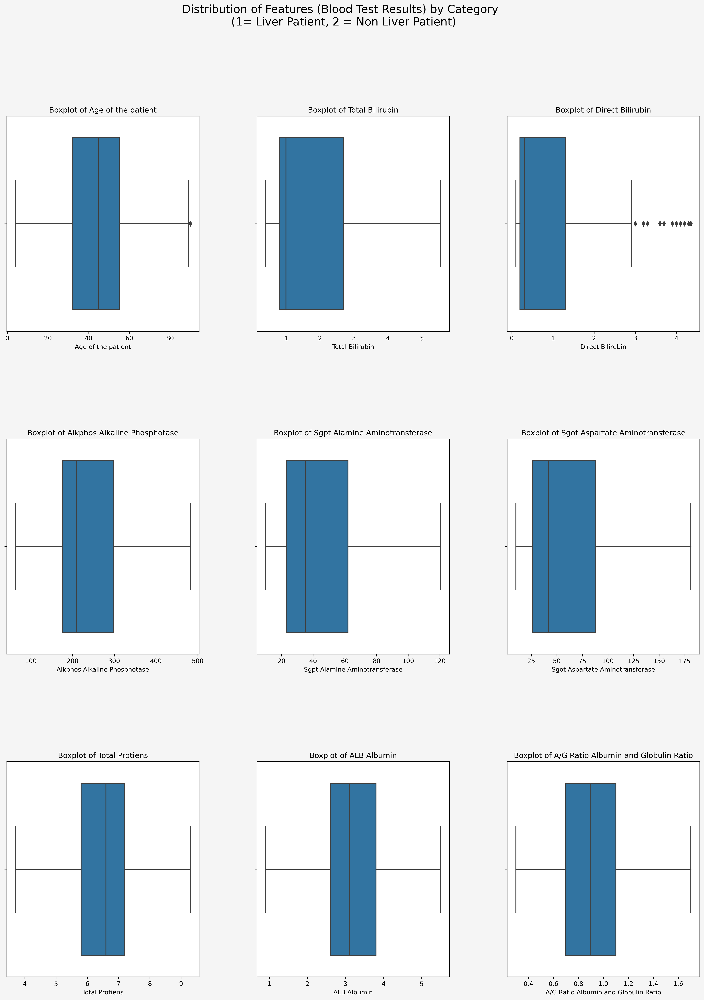

In [30]:
#set the figure and axes
fig, axes = plt.subplots(3, 3, figsize=(20, 25))
axes = axes.flatten()
fig.patch.set_facecolor('#f5f5f5')

# The columns to plot. Remove the target variable
df_cap_new = new_df_cap.drop(['Result','Gender of the patient'] , axis=1)

# Plot a histogram for each feature
for index,column in enumerate(df_cap_new.columns):
    sns.boxplot(x=df_cap_new[column], ax=axes[index])
    axes[index].set_title(f"Boxplot of {column}")

#Figure Title
fig.suptitle("Distribution of Features (Blood Test Results) by Category \n (1= Liver Patient, 2 = Non Liver Patient)", fontsize=18)

# Set the spacing between subplots
plt.subplots_adjust(hspace=0.5, wspace=0.3)


**Check for missing values**

In [31]:
new_df_cap.isna().sum()

Age of the patient                        2
Gender of the patient                   902
Total Bilirubin                         648
Direct Bilirubin                        561
Alkphos Alkaline Phosphotase            796
Sgpt Alamine Aminotransferase           538
Sgot Aspartate Aminotransferase         462
Total Protiens                          463
ALB Albumin                             494
A/G Ratio Albumin and Globulin Ratio    559
Result                                    0
dtype: int64

Output: This dataset has missing values. The number of missing values for each feature is shown above.


**Fill missing values with  mean of the column for numerical data and max frequent item for categorical data**

In [32]:
#For categorical data, replace missing values with highest frequency value
new_df_cap['Gender of the patient'].fillna(new_df_cap['Gender of the patient'].mode()[0], inplace=True)

#For numerical values we replace the missing values with average value
new_df_cap['Total Bilirubin'].fillna(new_df_cap['Total Bilirubin'].mean(), inplace=True)
new_df_cap['Age of the patient'].fillna(new_df_cap['Age of the patient'].mean(), inplace=True)
new_df_cap['Direct Bilirubin'].fillna(new_df_cap['Direct Bilirubin'].mean(), inplace=True)
new_df_cap['Alkphos Alkaline Phosphotase'].fillna(new_df_cap['Alkphos Alkaline Phosphotase'].mean(), inplace=True)
new_df_cap['Sgpt Alamine Aminotransferase'].fillna(new_df_cap['Sgpt Alamine Aminotransferase'].mean(), inplace=True)
new_df_cap['Sgot Aspartate Aminotransferase'].fillna(new_df_cap['Sgot Aspartate Aminotransferase'].mean(), inplace=True)
new_df_cap['Total Protiens'].fillna(new_df_cap['Total Protiens'].mean(), inplace=True)
new_df_cap['ALB Albumin'].fillna(new_df_cap['ALB Albumin'].mean(), inplace=True)
new_df_cap['A/G Ratio Albumin and Globulin Ratio'].fillna(new_df_cap['A/G Ratio Albumin and Globulin Ratio'].mean(), inplace=True)

In [33]:
#Check for missing values after replacing data.
new_df_cap.isna().sum()

Age of the patient                      0
Gender of the patient                   0
Total Bilirubin                         0
Direct Bilirubin                        0
Alkphos Alkaline Phosphotase            0
Sgpt Alamine Aminotransferase           0
Sgot Aspartate Aminotransferase         0
Total Protiens                          0
ALB Albumin                             0
A/G Ratio Albumin and Globulin Ratio    0
Result                                  0
dtype: int64

## 3.1 Data Analysis and Visualization of Dataset Features

**Category Analysis : Liver Patient vs Non-Liver Patient**

In [451]:
#Get the target names in the dataset
class_names = new_df_cap['Result'].unique()
print(class_names)

[1 2]


**In this dataset, class 1 means the patient has a liver disease and class 2 means patient does not have a liver disease.**

In [452]:
#Print the number of patients with or without liver disease.
target = new_df_cap['Result'].value_counts()
print(target)

Result
1    21917
2     8774
Name: count, dtype: int64


**Percentage of patient with or without liver diseases**

In [453]:
print("Percentage of patience with liver disease: "+str(round(target[1]*100/30691,2)))
print("Percentage of patience without liver disease: "+str(round(target[2]*100/30691,2)))

Percentage of patience with liver disease: 71.41
Percentage of patience without liver disease: 28.59


**Visualise the liver and non-liver patient count**

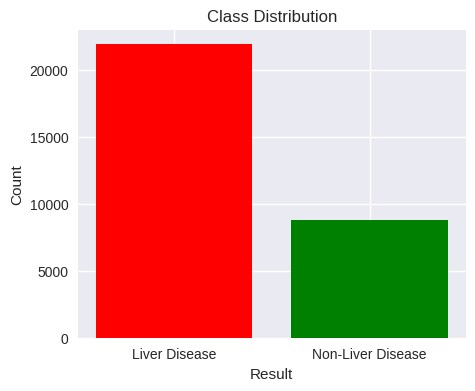

In [454]:
# Count the number of instances in each class
class_counts = new_df_cap['Result'].value_counts()

# Plot the class distribution
beingsaved = plt.figure(figsize=(5, 4))
colors = ['red', 'green']
plt.bar(['Liver Disease', 'Non-Liver Disease'], class_counts.values, color=colors)
plt.xlabel('Result')
plt.ylabel('Count')
plt.title('Class Distribution')
plt.show()

**Observation: The dataset consist with more class 1 (Liver patient) data than class 2 (Non-liver patient).
Therefore, the dataset has class imbalance and need to apply oversampling or undersampling technique for the dataset.**

### Gender Analysis

In [34]:
new_df_cap["Gender of the patient"].value_counts()

Gender of the patient
Male      22888
Female     7803
Name: count, dtype: int64

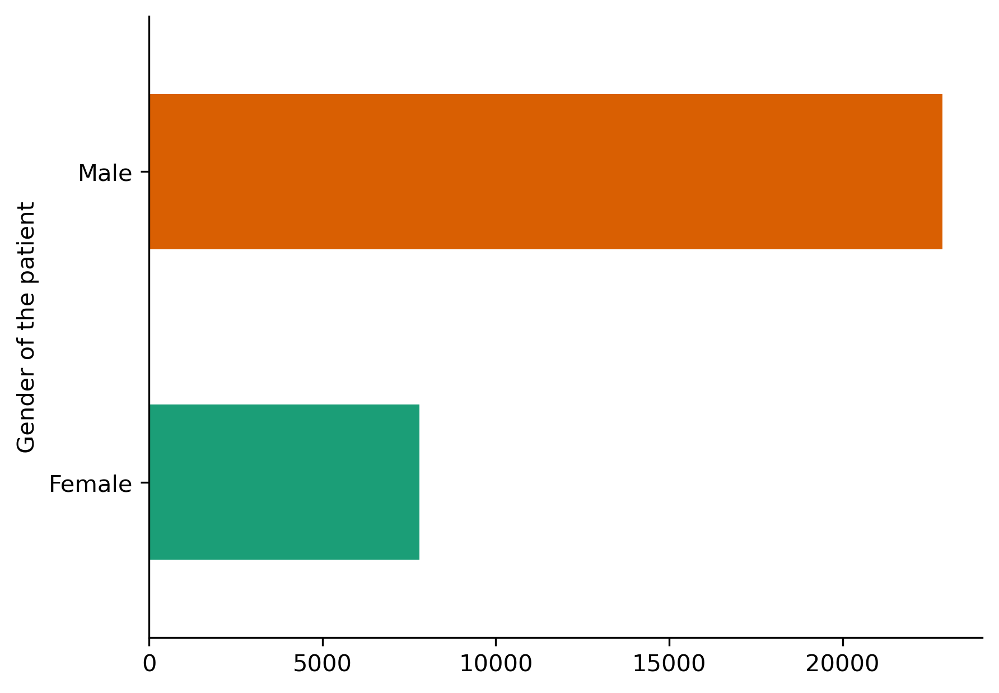

In [35]:
new_df_cap.groupby('Gender of the patient').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

Observation: The dataset consist with more male patient data than the feamle patients.

**Gender Analysis by Category**

In [36]:
#maps target feature 
data = new_df_cap.copy()
target_map = {1: 'Liver Patient',
             2: 'Non-Liver Patient'}

data['Result'] = data['Result'].map(lambda x: target_map[x])

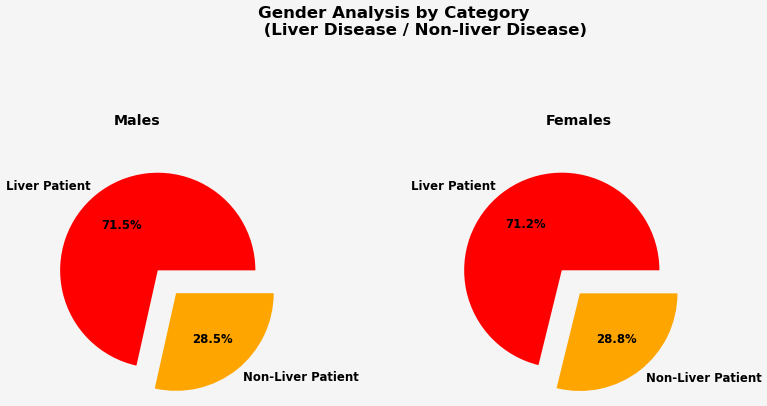

<Figure size 1920x1440 with 0 Axes>

In [37]:
#plots univariate analysis of Sex
fig = plt.figure(figsize = (24,10), dpi = 60)
gs = GridSpec(ncols=13, nrows=5, left=0.05, right=0.5, wspace=0.2, hspace=0.1)
fig.patch.set_facecolor('#f5f5f5')

#Set the title of the graph
fig.text(0.2, 0.9, 'Gender Analysis by Category \n (Liver Disease / Non-liver Disease)',fontweight="bold",fontsize = 20) 

axe1 = fig.add_subplot(gs[:, 0:5])
axe2 = fig.add_subplot(gs[:, 8:])

#Set the category of the first pie chart
fig.text(0.1, 0.75, 'Males',fontweight="bold",fontsize = 17)
axe1.pie(new_df_cap[new_df_cap['Gender of the patient'] == 'Male'].groupby('Result').Result.count().values, 
                   labels=data.groupby('Result').Result.count().index,
                    autopct='%1.1f%%', explode=[0.1, 0.2],
                   colors=['red', 'orange'],textprops={'fontsize': 14,'fontweight':'bold'})

#Set the category of the second pie chart
fig.text(0.4, 0.75, 'Females',fontweight="bold",fontsize = 17) 
axe2.pie(new_df_cap[new_df_cap['Gender of the patient'] == 'Female'].groupby('Result').Result.count().values, 
                   labels=data.groupby('Result').Result.count().index, autopct='%1.1f%%', explode=[0.1, 0.2], 
         textprops={'fontsize': 14,'fontweight':'bold'}, colors=['red', 'orange'])

plt.show()
plt.savefig('gender-analysis.png')

### Age Analysis

<Axes: xlabel='Age of the patient', ylabel='Density'>

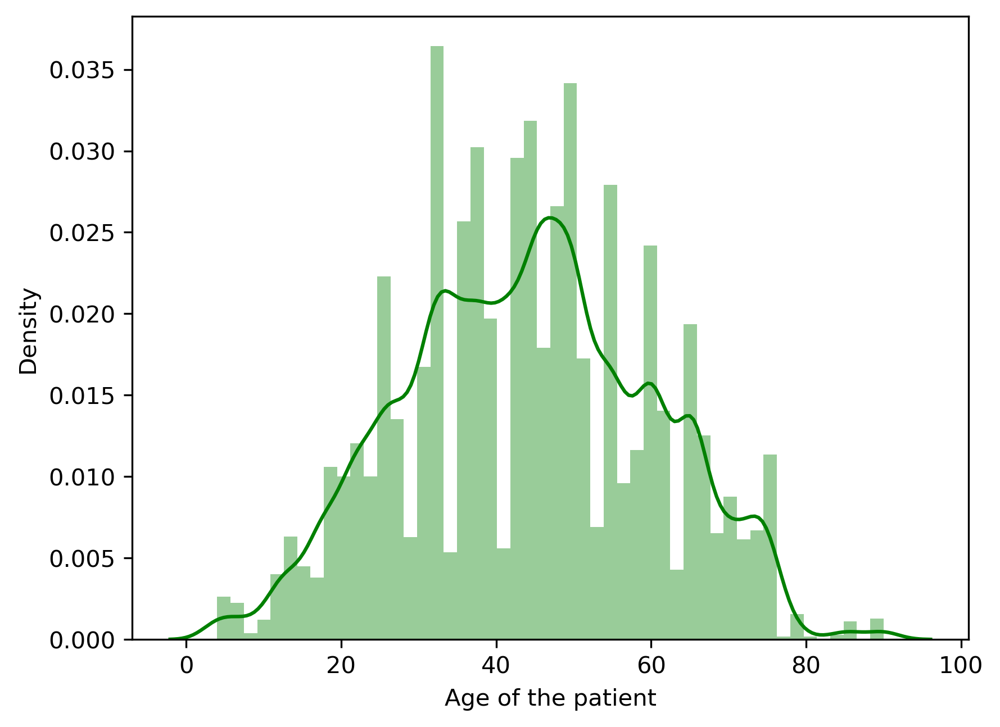

In [38]:
sns.distplot(data['Age of the patient'],color='green')

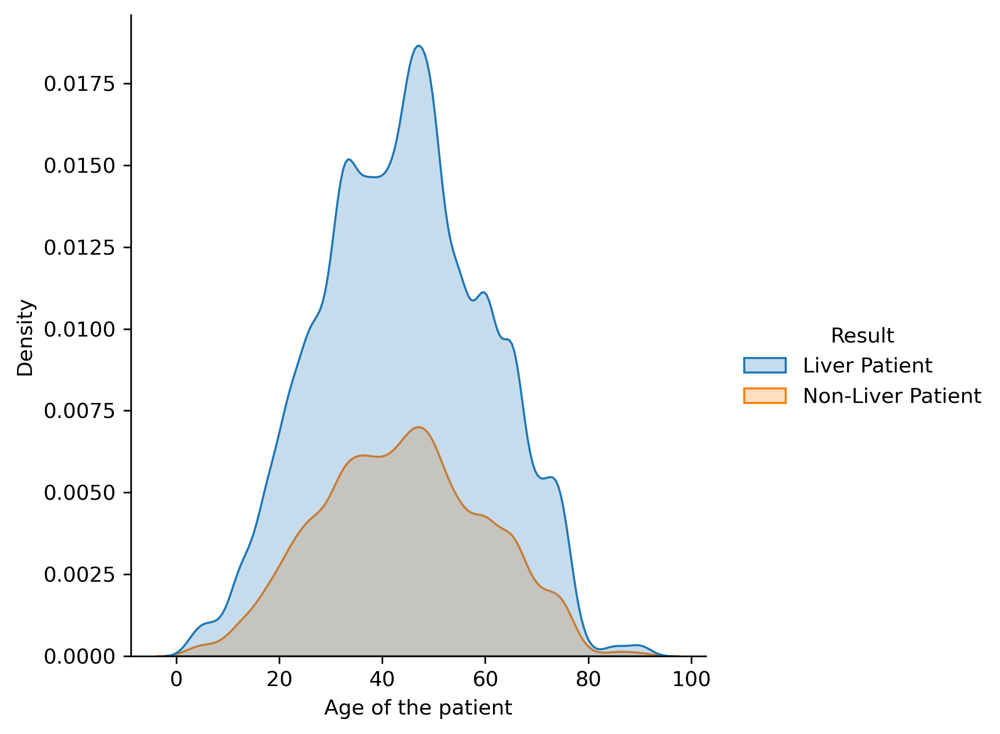

In [169]:
sns.displot(data, x="Age of the patient", hue="Result", kind="kde", fill=True)

### ALB Albumin Level Analysis

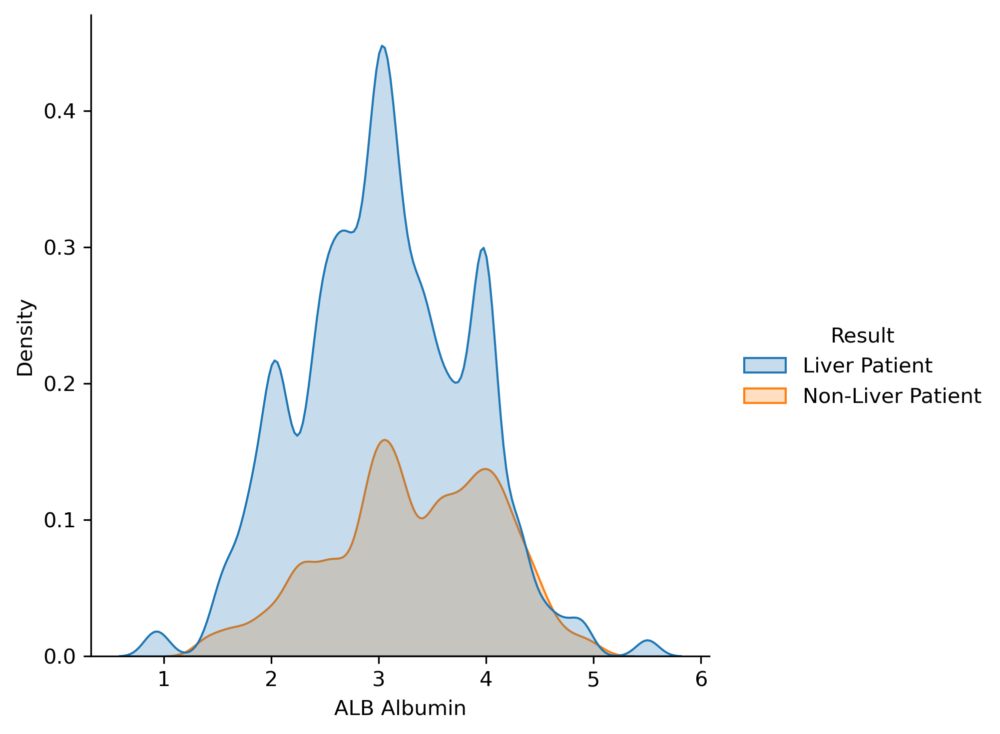

In [157]:
sns.displot(data, x="ALB Albumin", hue="Result", kind="kde", fill=True)

**ALB Albumin Level with Gender**

<Axes: xlabel='ALB Albumin', ylabel='Result'>

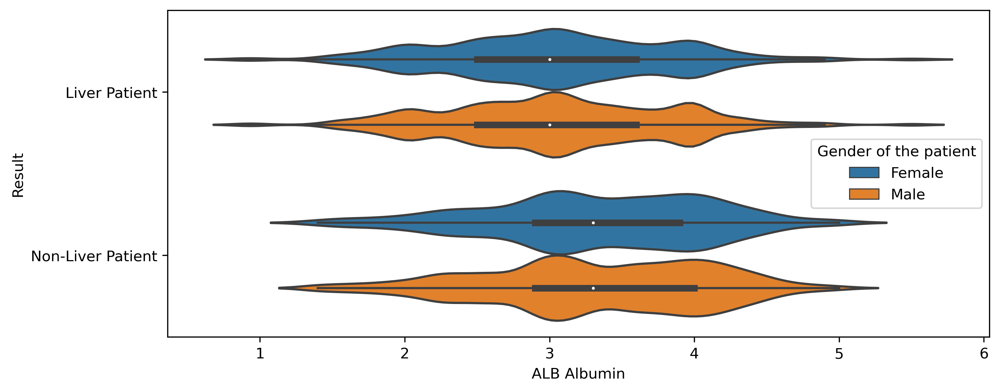

In [141]:
plt.figure(figsize=(10, 4))
sns.violinplot(data=data, x=data["ALB Albumin"], y=data["Result"], hue="Gender of the patient")

Observation: ALB Albumin level low indicates the patient has liver problem.

### Alkphos Alkaline Phosphotase Analysis

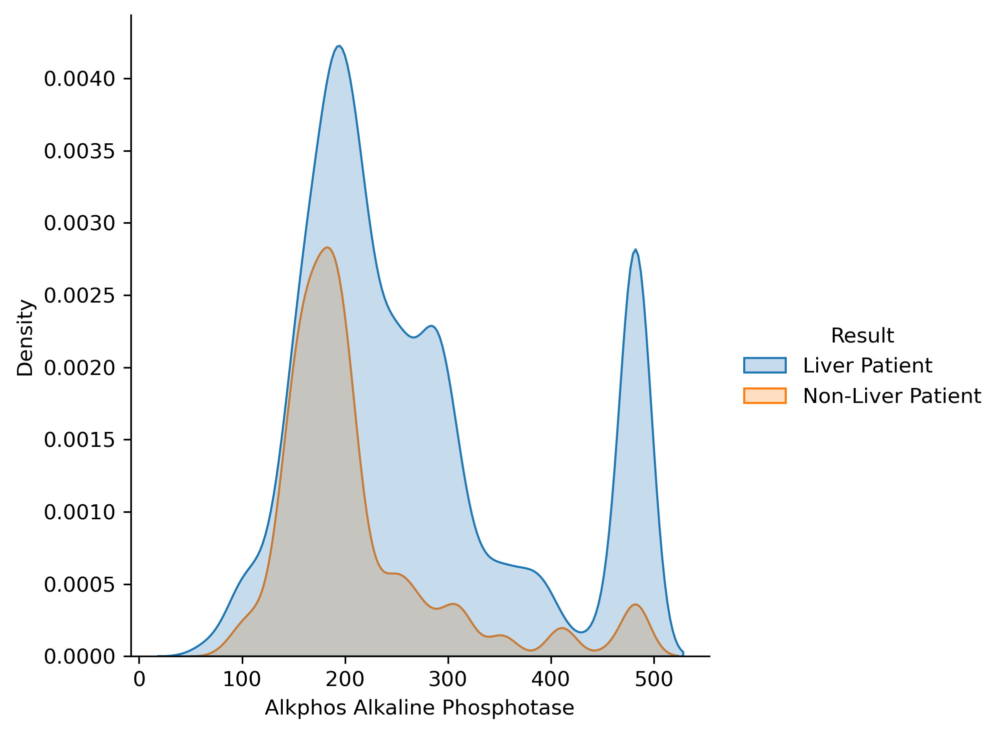

In [155]:
sns.displot(data, x="Alkphos Alkaline Phosphotase", hue="Result", kind="kde", fill=True)

<Axes: xlabel='Alkphos Alkaline Phosphotase', ylabel='Result'>

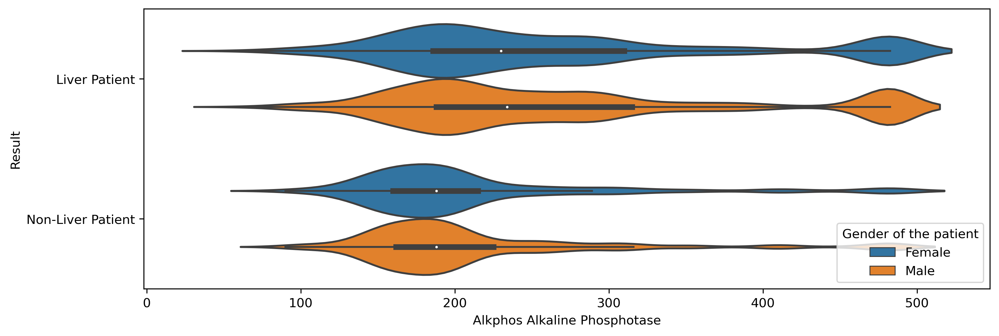

In [159]:
plt.figure(figsize=(12, 4))
sns.violinplot(data=data, x=data["Alkphos Alkaline Phosphotase"], y=data["Result"], hue="Gender of the patient")

### A/G Ratio Albumin and Globulin Ratio Analysis

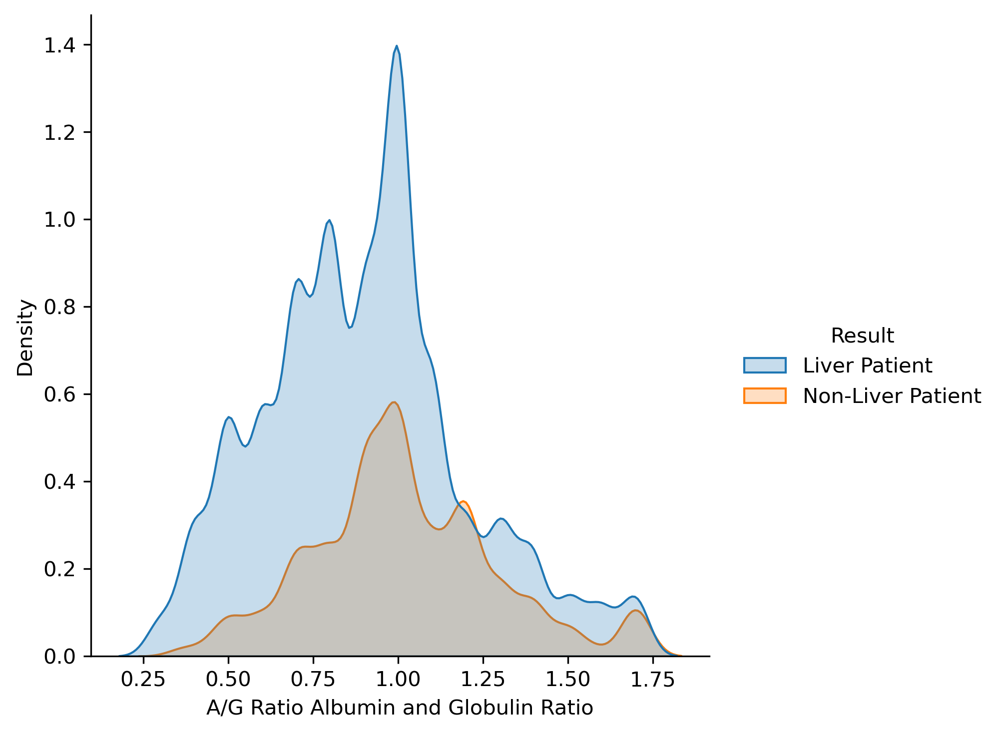

In [165]:
sns.displot(data, x="A/G Ratio Albumin and Globulin Ratio", hue="Result", kind="kde", fill=True)

<Axes: xlabel='A/G Ratio Albumin and Globulin Ratio', ylabel='Result'>

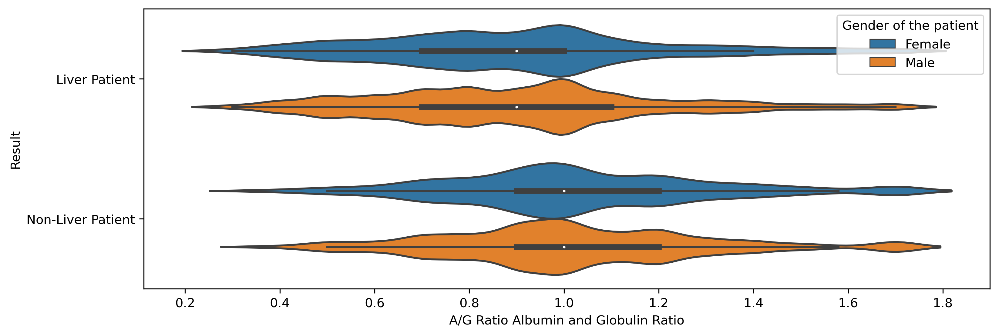

In [166]:
plt.figure(figsize=(12, 4))
sns.violinplot(data=data, x=data["A/G Ratio Albumin and Globulin Ratio"], y=data["Result"], hue="Gender of the patient")

### Total Protein Analysis

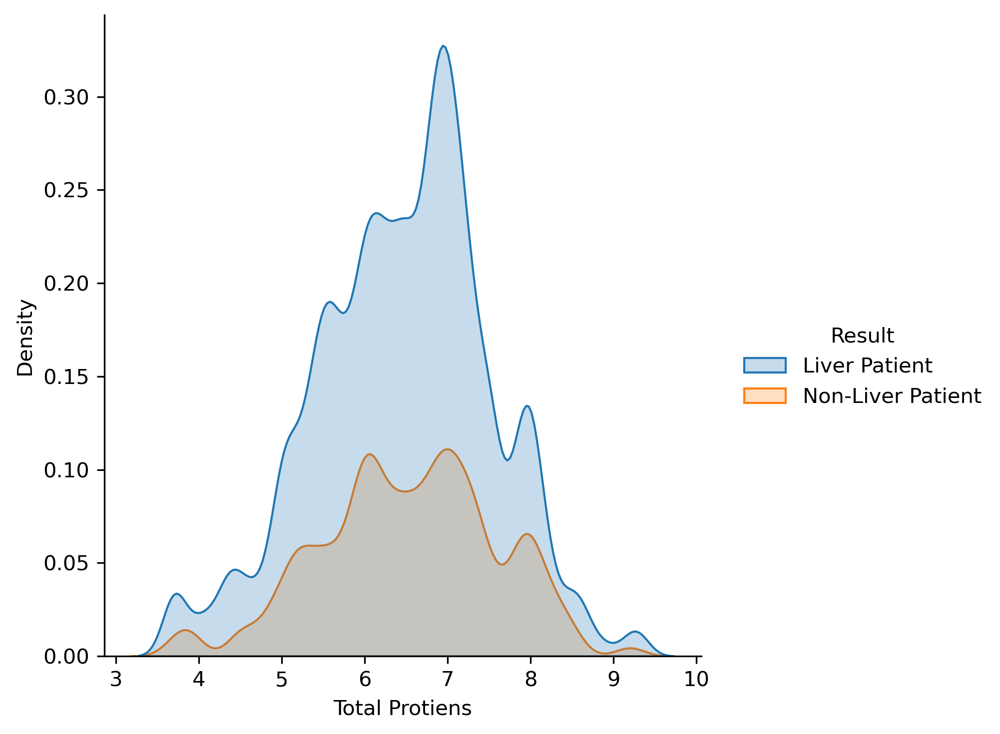

In [167]:
sns.displot(data, x="Total Protiens", hue="Result", kind="kde", fill=True)

<Axes: xlabel='Total Protiens', ylabel='Result'>

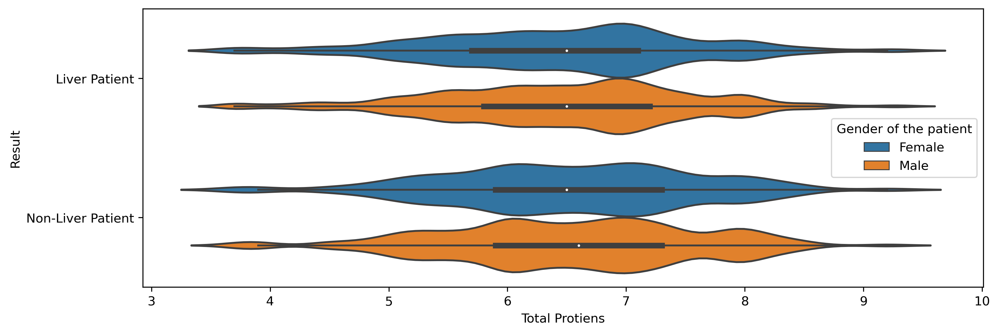

In [170]:
plt.figure(figsize=(12, 4))
sns.violinplot(data=data, x=data["Total Protiens"], y=data["Result"], hue="Gender of the patient")

### Bivariate Analysis of All Features

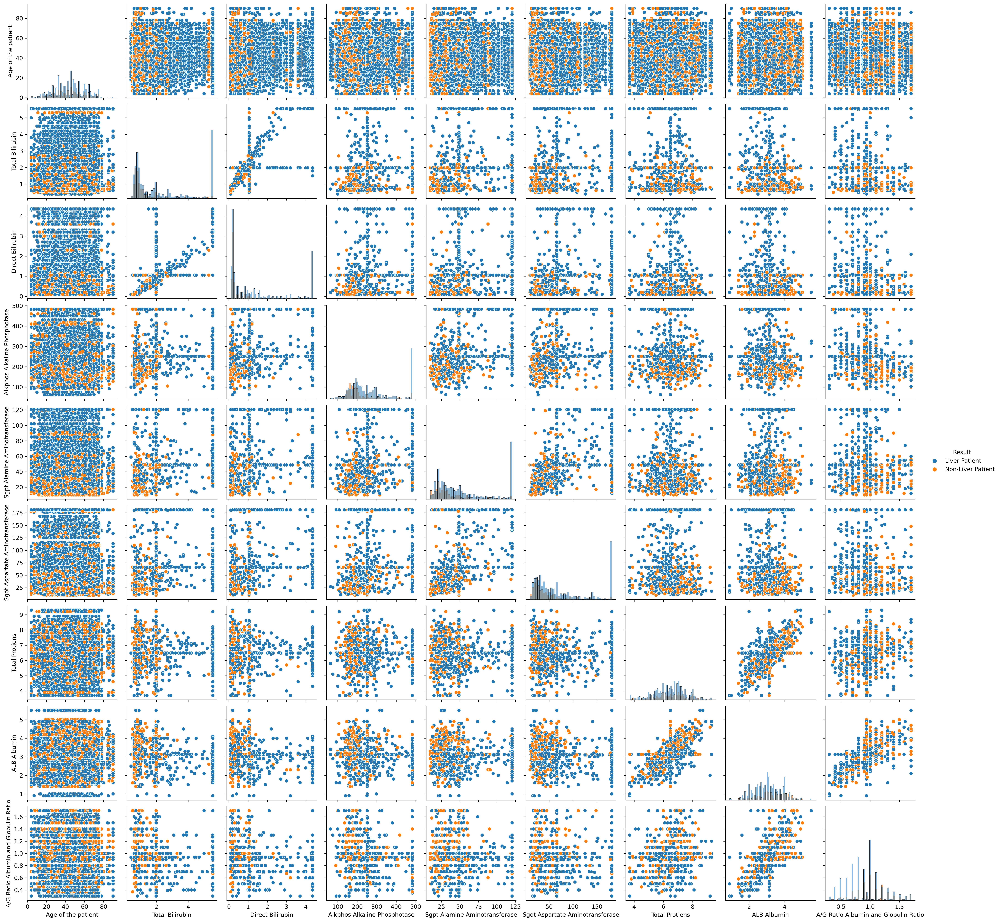

In [135]:
sns.pairplot(data, hue="Result", diag_kind="hist")

# 3. Train and Evaluate Models

**Handling Categorical Variable**

In [31]:
processed_data = new_df_cap.copy()

categorical_columns = processed_data.select_dtypes(include = object).columns
categorical_columns

Index(['Gender of the patient'], dtype='object')

**Converting categorical label; Gender into numerical value**

In [32]:
le = preprocessing.LabelEncoder()
for cat_colmn in categorical_columns:
    processed_data[cat_colmn] = le.fit_transform(processed_data[cat_colmn])

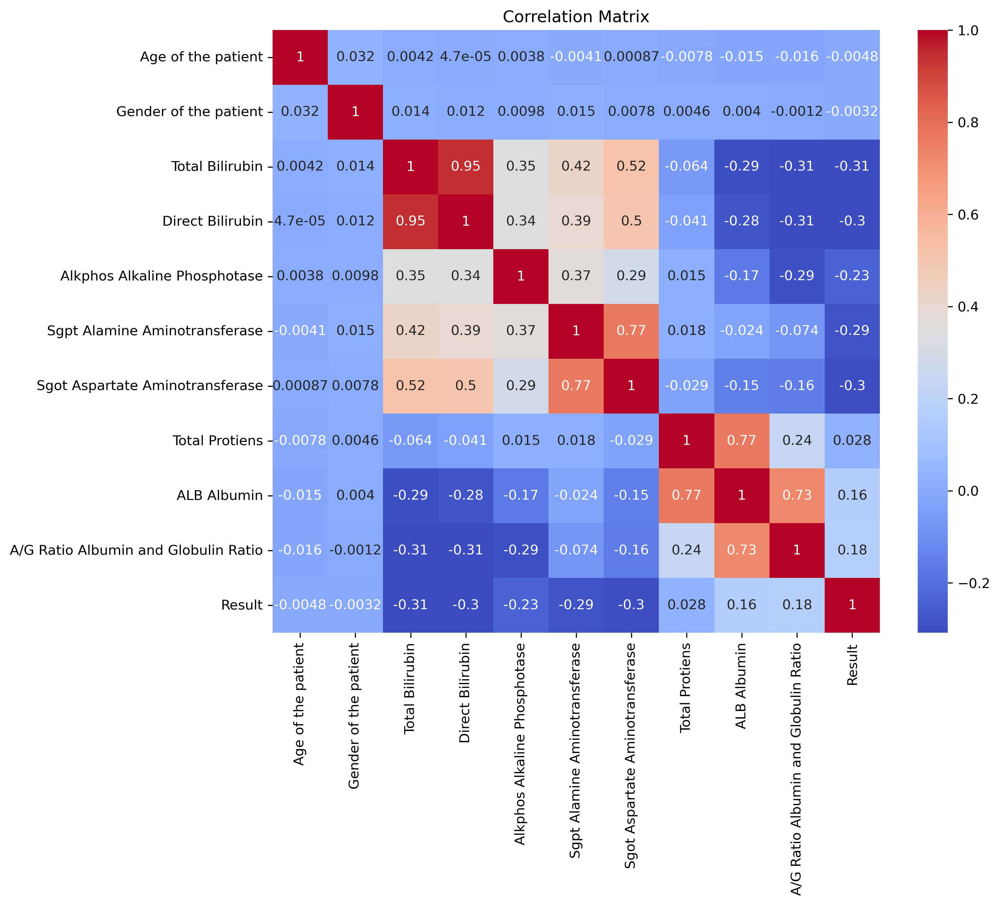

In [33]:
# Calculate the c
correlation_matrix = processed_data.corr()

# Create a heatmap of the correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

In [34]:
#print dataframe after encoding gender column.
processed_data.head()

,Age of the patient,Gender of the patient,Total Bilirubin,Direct Bilirubin,Alkphos Alkaline Phosphotase,Sgpt Alamine Aminotransferase,Sgot Aspartate Aminotransferase,Total Protiens,ALB Albumin,A/G Ratio Albumin and Globulin Ratio,Result
0,65.0,0,0.70,0.10,187.0,16.0,18.0,6.8,3.3,0.90,1
1,62.0,1,5.55,4.35,482.5,64.0,100.0,7.5,3.2,0.74,1
2,62.0,1,5.55,4.10,482.5,60.0,68.0,7.0,3.3,0.89,1
3,58.0,1,1.00,0.40,182.0,14.0,20.0,6.8,3.4,1.00,1
4,72.0,1,3.90,2.00,195.0,27.0,59.0,7.3,2.4,0.40,1


**Balance Dataset with SMOTE**

As observed earlier dataset is imbalance. Therefore, oversampling technique needs to be applied to the dataset.

In [35]:
# create the  object with the desired sampling strategy. The process will be done in kfold validation.
smote = SMOTE(sampling_strategy='minority')

stdScalar = StandardScaler()

In [36]:
#Assign features except for the target column to the X variable
X = processed_data.drop("Result", axis=1)

#Assign target variable, "Result" to y variable
y = processed_data["Result"]

### Nested KFold Cross Validation with Hyper-paramter Tunning

In [37]:
#This method implements the nested k-fold validation.
def nested_kfold_validation(classifier, param_grid, X, y):
    
    best_score = -np.inf #Define variable to store the best accuracy
    accuracy_list = []   #Define the list to store accuracy for each fold
    precision_list = []  #Define the list to store precision for each fold
    recall_list = []     #Define the list to store recall for each fold
    final_model = None   #Define the variable to store the best final model
    
    k=5
    cv_outer = KFold(n_splits=k, random_state=42, shuffle=True)
    
    for train_index, test_index in cv_outer.split(X):
        #Split data to train and test
        X_train, X_test = X.iloc[train_index, :], X.iloc[test_index, :]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        #resampling the training data using SMOTE
        x_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)
    
        #data normalisation
        x_train_normalised = stdScalar.fit_transform(x_train_smote)
        x_test_normalised = stdScalar.transform(X_test)

        #configure cross validation 
        cv_inner = KFold(n_splits=2, random_state=42, shuffle=True)
    
        #define the GridSearchCV object
        grid_search = GridSearchCV(classifier, param_grid, cv=cv_inner, scoring='accuracy', return_train_score=True,n_jobs=6)
    
        # Fit the model to the data
        result = grid_search.fit(x_train_normalised, y_train_smote)

        #get the best performing model
        best_model = result.best_estimator_

        #evaluate the model with the hold out data
        predicted_labels = best_model.predict(x_test_normalised)
    
        # evaluate the model
        acc = accuracy_score(y_test, predicted_labels)
        accuracy_list.append(acc)
    
        precision = precision_score(y_test, predicted_labels)
        precision_list.append(precision)
    
        recall = recall_score(y_test, predicted_labels)
        recall_list.append(recall)
    
        # Update the best model and best score if the current model performs better
        if acc > best_score:
            best_score = acc
            final_model = best_model
            
    return accuracy_list, precision_list, recall_list, final_model, x_test_normalised, y_test

In [182]:
#This method implements the nested k-fold validation.
def nested_kfold_validation_KNN(classifier, param_grid, X, y):
    
    best_score = -np.inf #Define variable to store the best accuracy
    accuracy_list = []   #Define the list to store accuracy for each fold
    precision_list = []  #Define the list to store precision for each fold
    recall_list = []     #Define the list to store recall for each fold
    final_model = None   #Define the variable to store the best final model
    
    k=5
    cv_outer = KFold(n_splits=k, random_state=100, shuffle=True)
    
    for train_index, test_index in cv_outer.split(X):
        #Split data to train and test
        X_train, X_test = X.iloc[train_index, :], X.iloc[test_index, :]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        #resampling the training data using SMOTE
        x_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)
    
        #data normalisation
        x_train_normalised = stdScalar.fit_transform(x_train_smote)
        x_test_normalised = stdScalar.transform(X_test)

        #configure cross validation 
        cv_inner = KFold(n_splits=3, random_state=7, shuffle=True)
    
        #define the GridSearchCV object
        grid_search = GridSearchCV(classifier, param_grid, cv=cv_inner, scoring='accuracy', return_train_score=True,refit=True,n_jobs=6)
    
        # Fit the model to the data
        result = grid_search.fit(x_train_normalised, y_train_smote)

        #get the best performing model
        best_model = result.best_estimator_

        #evaluate the model with the hold out data
        predicted_labels = best_model.predict(x_test_normalised)
    
        # evaluate the model
        acc = accuracy_score(y_test, predicted_labels)
        accuracy_list.append(acc)
    
        precision = precision_score(y_test, predicted_labels)
        precision_list.append(precision)
    
        recall = recall_score(y_test, predicted_labels)
        recall_list.append(recall)
    
        # Update the best model and best score if the current model performs better
        if acc > best_score:
            best_score = acc
            final_model = best_model
            
    return accuracy_list, precision_list, recall_list, final_model, x_test_normalised, y_test

**Evaluate best model**

In [38]:
#This method evaluates the results obtained from k-fold
def evaulate_model(accuracy_list, precision_list, recall_list, final_model,x_test_normalised,y_test):
    
    #Print each fold with accuracy, precision and recall
    print("Accuracy for each fold :", accuracy_list)
    print("Precision for each fold :", precision_list)
    print("Recall for each fold :", recall_list)
    
    # Print average performance metrics
    print('Average Accuracy: %.3f (%.3f)' % (mean(accuracy_list), std(accuracy_list)))
    print('Average Precision: %.3f (%.3f)' % (mean(precision_list),std(precision_list)))
    print('Average Recall: %.3f (%.3f)'% (mean(recall_list),std(recall_list)))

    if final_model:
        #predict the result for the test data
        y_pred_best = final_model.predict(x_test_normalised)

        #calculate the confusion matrix using predicted results and true results
        matrix = confusion_matrix(y_test, y_pred_best)

        print("Confusion Matrix")
        sns.heatmap(matrix,annot = True, fmt = "d")   
    else:
        print("No best model found.")

### Draw ROC Curve

In [40]:
def draw_ROC_curve(final_model,xtest, ytest):
    
    pred_probability = final_model.predict_proba(xtest)
    
    y_true_binary = (ytest == 2).astype(int)
    fpr1, tpr1, _ = roc_curve(y_true_binary, pred_probability[::,1], pos_label=1)

    plt.style.use("seaborn-v0_8")
    plt.title('ROC curve: Liver Disease Prediction')
    plt.xlabel('FPR (Precision)') # false positive rate
    plt.ylabel('TPR (Recall)')   # true positive rate

    auc_score1 = roc_auc_score(ytest, pred_probability[:,1])
    print ('Area under curve (AUC): ', auc_score1) 
    plt.plot(fpr1,tpr1,label="AUC="+str(auc_score1))
    plt.plot((0,1), ls='dashed',color='black')
    plt.legend()
    plt.show()


### Test the models with Another Dataset

**The models were tested with another dataset consist with several biochemical markers to detect a person has liver disease.**

The dataset comprises 583 patient records and can be accessed via https://archive.ics.uci.edu/dataset/225/ilpd+indian+liver+patient+dataset

In [41]:
# load the dataset into dataframe
df_test = pd.read_csv(r"./Indian Liver Patient Dataset (ILPD).csv",encoding='unicode_escape',names=['Age of the patient', 'Gender of the patient','Total Bilirubin','Direct Bilirubin','Alkphos Alkaline Phosphotase','Sgpt Alamine Aminotransferase','Sgot Aspartate Aminotransferase','Total Protiens','ALB Albumin','A/G Ratio Albumin and Globulin Ratio','Result'])
df_test.head()

,Age of the patient,Gender of the patient,Total Bilirubin,Direct Bilirubin,Alkphos Alkaline Phosphotase,Sgpt Alamine Aminotransferase,Sgot Aspartate Aminotransferase,Total Protiens,ALB Albumin,A/G Ratio Albumin and Globulin Ratio,Result
0,65,Female,0.7,0.1,187,16,18,6.8,3.3,0.90,1
1,62,Male,10.9,5.5,699,64,100,7.5,3.2,0.74,1
2,62,Male,7.3,4.1,490,60,68,7.0,3.3,0.89,1
3,58,Male,1.0,0.4,182,14,20,6.8,3.4,1.00,1
4,72,Male,3.9,2.0,195,27,59,7.3,2.4,0.40,1


**Preprocess Test Dataset**

In [42]:
df_test.isna().sum()

Age of the patient                      0
Gender of the patient                   0
Total Bilirubin                         0
Direct Bilirubin                        0
Alkphos Alkaline Phosphotase            0
Sgpt Alamine Aminotransferase           0
Sgot Aspartate Aminotransferase         0
Total Protiens                          0
ALB Albumin                             0
A/G Ratio Albumin and Globulin Ratio    4
Result                                  0
dtype: int64

In [43]:
#Drop null values in the test dataset
df_test =df_test.dropna()

In [44]:
#check for categorical columns in test dataset
categorical_col_test = df_test.select_dtypes(include = object).columns
categorical_col_test

Index(['Gender of the patient'], dtype='object')

In [45]:
#Encode categorical columns
for cat_colmn_test in categorical_col_test:
    df_test[cat_colmn_test] = le.transform(df_test[cat_colmn_test])

In [46]:
x_features = df_test.drop('Result', axis=1)

#Assign target variable, "Target" to y variable
y_target = df_test['Result']


### 1.  KNN

**KNN classifier using nested kfold.**

In [183]:
from sklearn.neighbors import KNeighborsClassifier

#Parameters for hyperparameter tunning
param_grid = {
    'n_neighbors': list(range(3, 10)),
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree'],
    'p': [1, 2],
    'metric': ['euclidean', 'manhattan','minkowski']
}

knn = KNeighborsClassifier(n_jobs=6)

#Call nested k-fold validation method for KNN
accuracy_KNN, precision_KNN, recall_KNN, knn_exp_model, x_test_normalised_KNN, y_test_KNN = nested_kfold_validation_KNN(knn,param_grid,X,y) 
print('KNN best model parameters :' , knn_exp_model)

KNN best model parameters : KNeighborsClassifier(metric='manhattan', n_jobs=6, n_neighbors=3, p=1,
                     weights='distance')


Accuracy for each fold : [0.9915295650757452, 0.9915281850765721, 0.9921798631476051, 0.9926686217008798, 0.9939719778429456]
Precision for each fold : [0.9963277484507689, 0.995632183908046, 0.9947751022262608, 0.9963570127504554, 0.9963319578175149]
Recall for each fold : [0.9917751884852639, 0.9924381301558204, 0.9943233424159855, 0.993416572077185, 0.9951912067781086]
Average Accuracy: 0.992 (0.001)
Average Precision: 0.996 (0.001)
Average Recall: 0.993 (0.001)
Confusion Matrix


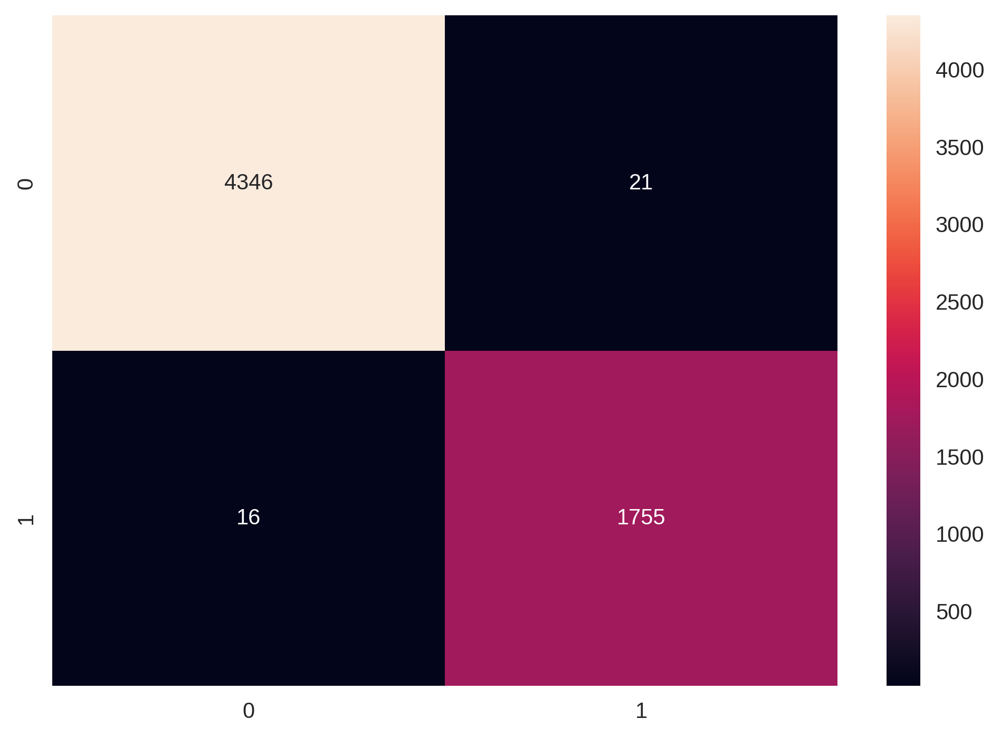

In [184]:
evaulate_model(accuracy_KNN, precision_KNN, recall_KNN, knn_exp_model, x_test_normalised_KNN, y_test_KNN)

In [185]:
# save the svm model to disk as it take lots of time to train
filename = 'final_EXP_KNN_model.sav'
pickle.dump(knn_exp_model, open(filename, 'wb'))

**ROC Curve for KNN**

Area under curve (AUC):  0.9961828078433848


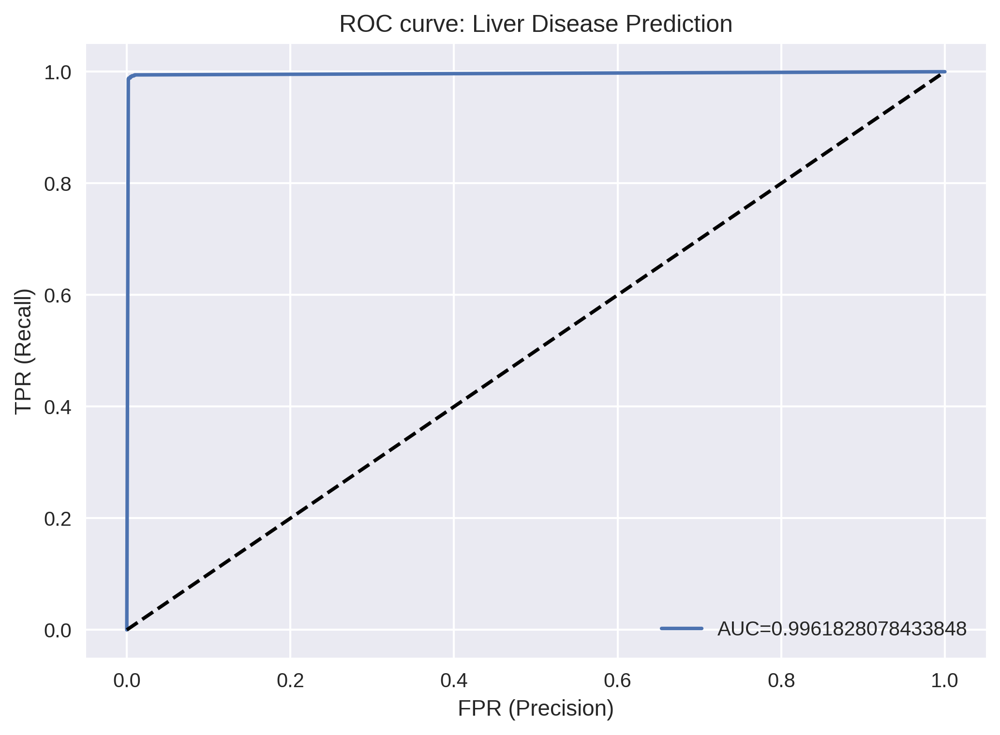

In [186]:
# roc curve for KNN final_model
draw_ROC_curve(knn_exp_model,x_test_normalised_KNN, y_test_KNN)

**Prediction with another dataset**

KNeighborsClassifier(metric='manhattan', n_jobs=6, n_neighbors=3, p=1,
                     weights='distance')
Accuracy for test dataset 0.998272884283247
Precision for test dataset 1.0
Recall for test dataset 0.9975845410628019


<Axes: >

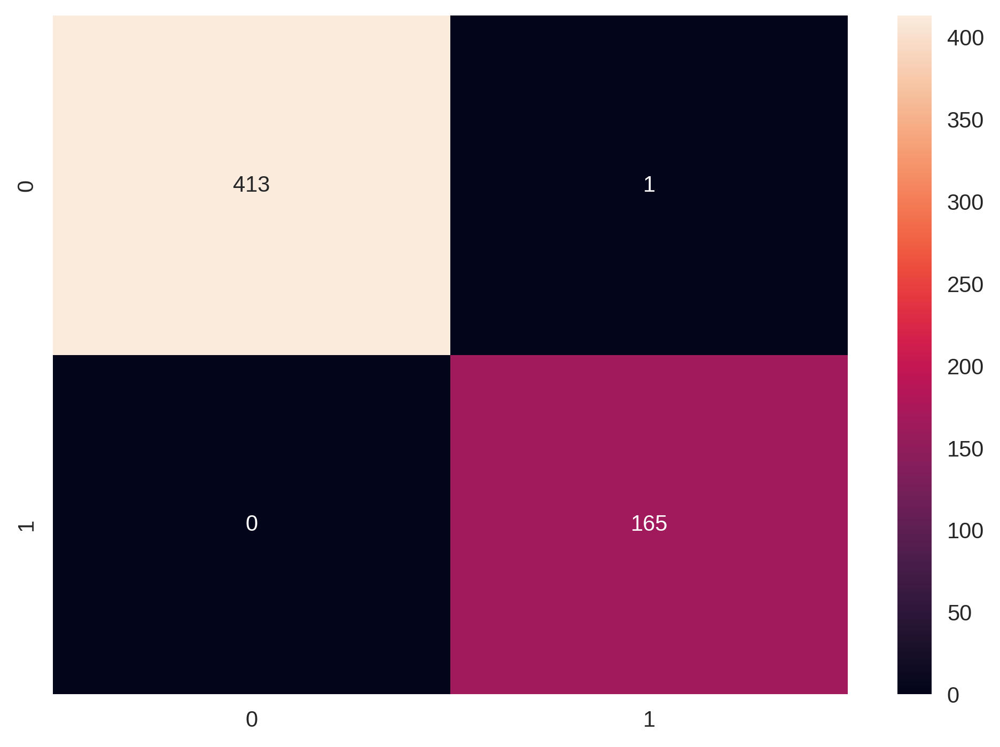

In [187]:
test_normalised = stdScalar.transform(x_features)

load_knn_file = 'final_EXP_KNN_model.sav'

loaded_knn_model = pickle.load(open(load_knn_file, 'rb'))
print(loaded_knn_model)

pred_test_KNN = loaded_knn_model.predict(test_normalised)

print('Accuracy for test dataset',accuracy_score(y_target, pred_test_KNN))
print('Precision for test dataset',precision_score(y_target, pred_test_KNN))
print('Recall for test dataset',recall_score(y_target, pred_test_KNN))

matrix_KNN = confusion_matrix(y_target, pred_test_KNN)
sns.heatmap(matrix_KNN,annot = True, fmt = "d")  

### 2. Random Forest

**Random Forest classifier using nested kfold.**

In [47]:
from sklearn.ensemble import RandomForestClassifier

param_grid = {
    'n_estimators': [100, 200, 1000],
    'max_depth': [None, 10, 20],
    'criterion' : ["gini", "entropy", "log_loss"],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features':["sqrt", "log2", None]
}

# Define the classifier and its parameters
randomForestClassifier = RandomForestClassifier(random_state=1, n_jobs=6, bootstrap=True)
accuracy_list, precision_list, recall_list, rf_final_model, x_test_normalised, y_test = nested_kfold_validation(randomForestClassifier, param_grid, X, y)

print('Random Forest best model parameters :' , rf_final_model)

Random Forest best model parameters : RandomForestClassifier(criterion='entropy', n_estimators=1000, n_jobs=6,
                       random_state=1)


Accuracy for each fold : [0.9962534614758104, 0.996415770609319, 0.9969045291625936, 0.9982078853046595, 0.9970674486803519]
Precision for each fold : [0.9966185752930569, 0.9972708664998863, 0.9981818181818182, 0.9988495167970548, 0.9972407449988503]
Recall for each fold : [0.9981937231880785, 0.9977246871444824, 0.9975017033840563, 0.9986197377501725, 0.9986184664978126]
Average Accuracy: 0.997 (0.001)
Average Precision: 0.998 (0.001)
Average Recall: 0.998 (0.000)
Confusion Matrix


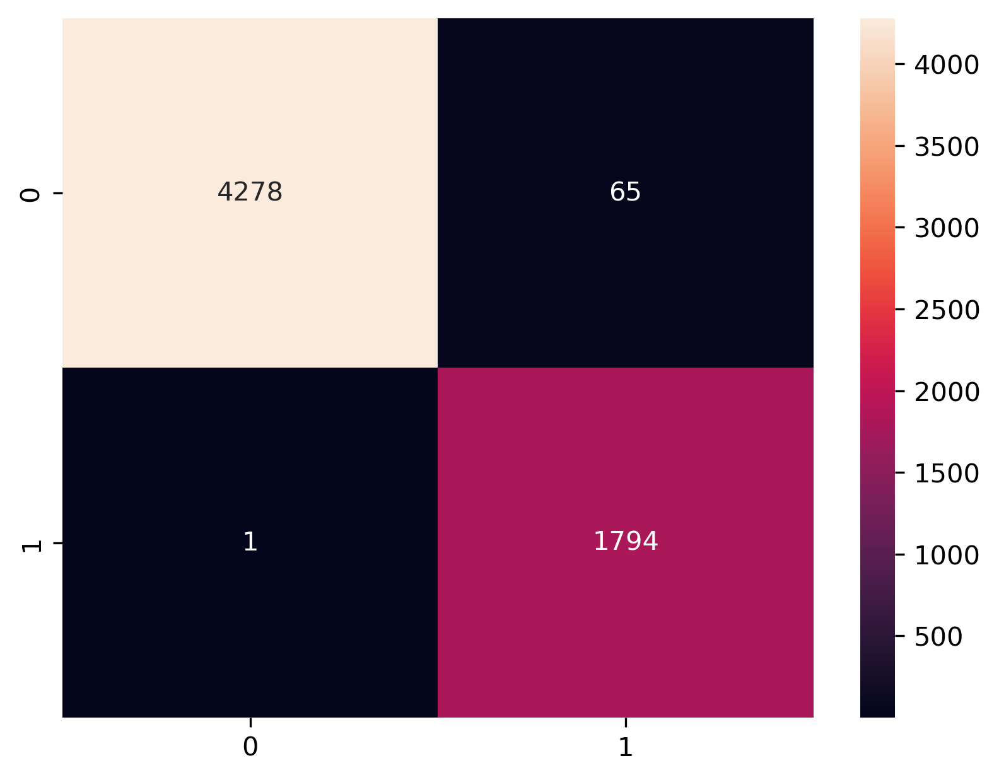

In [48]:
evaulate_model(accuracy_list, precision_list, recall_list, rf_final_model, x_test_normalised, y_test)

In [49]:
# save the svm model to disk as it take lots of time to train
filename = 'finalized_RF_model_with_all_features.sav'
pickle.dump(rf_final_model, open(filename, 'wb'))

**ROC Curve for Random Forest**

Area under curve (AUC):  0.9999429812774631


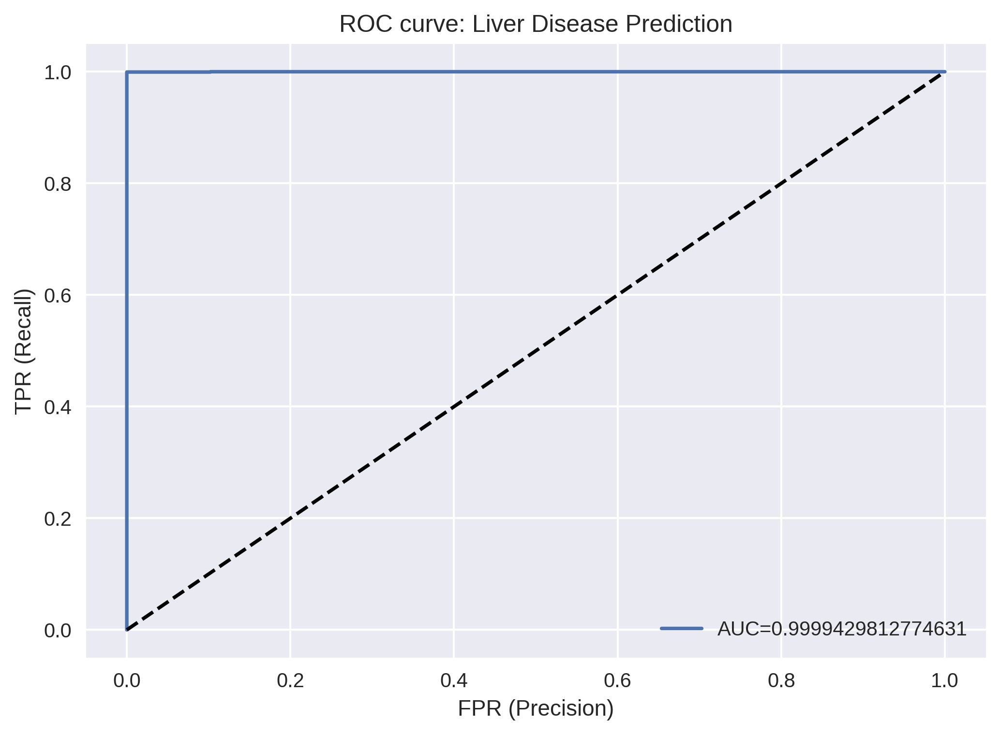

In [54]:
# roc curve for KNN final model
draw_ROC_curve(rf_final_model,x_test_normalised, y_test)

**Prediction using RandomForest**

RandomForestClassifier(criterion='entropy', n_estimators=1000, n_jobs=6,
                       random_state=1)
Accuracy for test dataset 0.9879101899827288
Precision for test dataset 1.0
Recall for test dataset 0.9830917874396136


<Axes: >

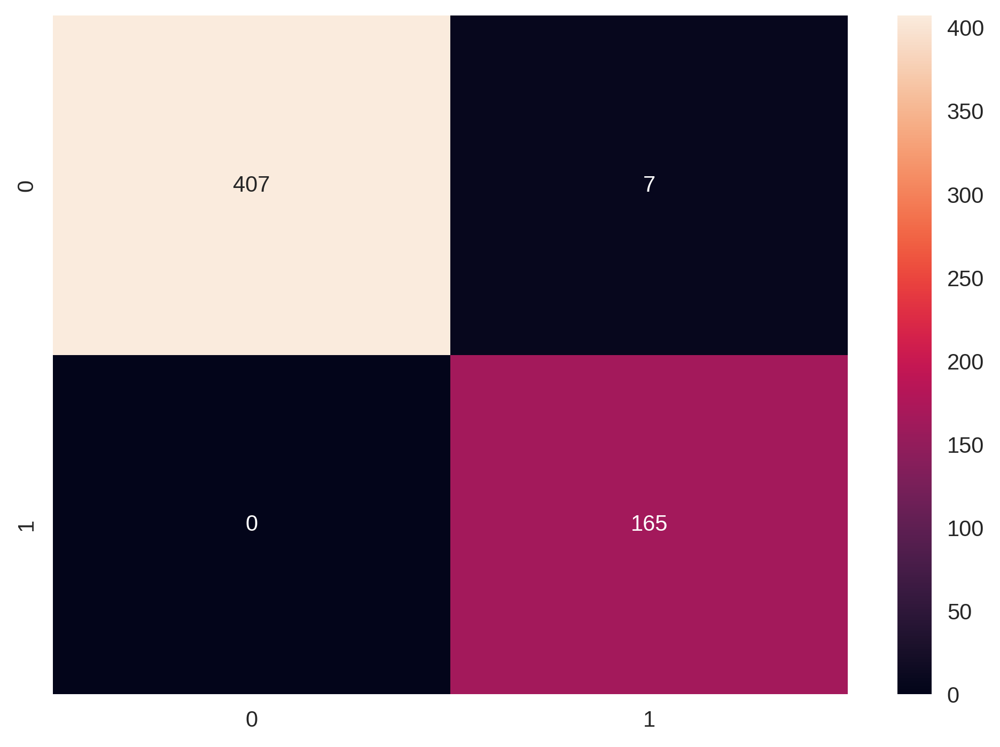

In [140]:
load_rf_file = 'finalized_RF_model_with_all_features.sav'

loaded_rf_model = pickle.load(open(load_rf_file, 'rb'))
print(loaded_rf_model)

rf_features = df_test.copy()
X_important_features = rf_features.drop(['Result'], axis=1)
xfeature_normalised = stdScalar.transform(X_important_features)

pred_test_RF = loaded_rf_model.predict(xfeature_normalised)

print('Accuracy for test dataset',accuracy_score(y_target, pred_test_RF))
print('Precision for test dataset',precision_score(y_target, pred_test_RF))
print('Recall for test dataset',recall_score(y_target, pred_test_RF))

matrix_RF = confusion_matrix(y_target, pred_test_RF)
sns.heatmap(matrix_RF,annot = True, fmt = "d")  

#### Find important features with Random Forest model

In [56]:
feature_scores = pd.Series(rf_final_model.feature_importances_, index=X.columns).sort_values(ascending=False)
print(feature_scores)

Alkphos Alkaline Phosphotase            0.155241
Sgpt Alamine Aminotransferase           0.152832
Sgot Aspartate Aminotransferase         0.144325
Total Bilirubin                         0.116371
Direct Bilirubin                        0.111189
Total Protiens                          0.108600
ALB Albumin                             0.105255
A/G Ratio Albumin and Globulin Ratio    0.098837
Age of the patient                      0.005897
Gender of the patient                   0.001454
dtype: float64


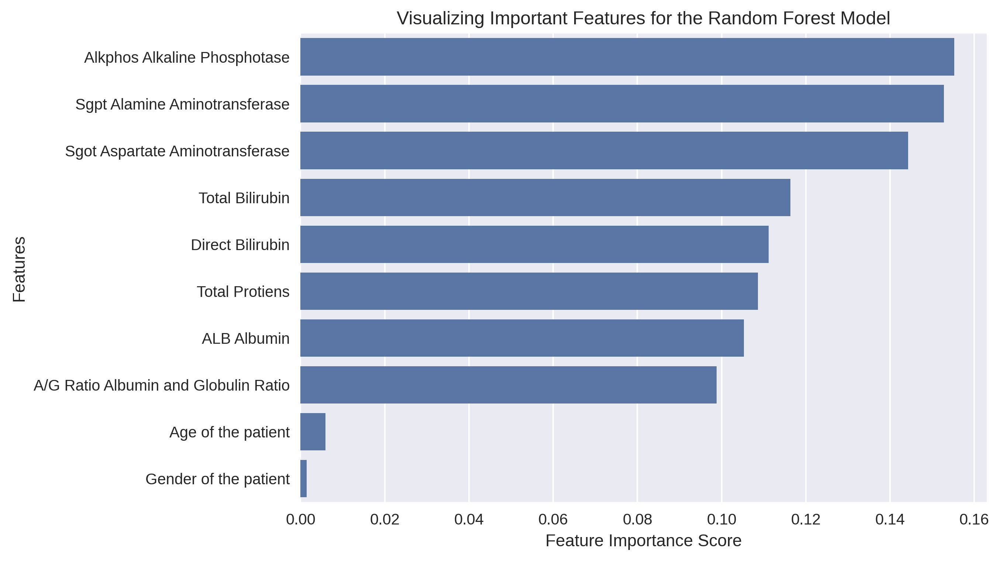

In [57]:
# Creating a bar plot
sns.barplot(x=feature_scores, y=feature_scores.index)

# Add labels to your graph
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')
plt.title("Visualizing Important Features for the Random Forest Model")
plt.show()

Interpretation
The above plot confirms that the most important feature is "Alkphos Alkaline Phosphotase" and the least important features are "Age of the patient", and "Gender of the patient".

**Now we are going to train the model with important features.**

In [58]:
#Copy the features and targets to a new variable and drop the values from it.
x_newData = X.copy()
y_newData = y.copy()
X_important_features = x_newData.drop(['Gender of the patient','Age of the patient'], axis=1)

In [59]:
param_grid = {
    'n_estimators': [100, 200, 1000],
    'max_depth': [None, 10, 20],
    'criterion' : ["gini", "entropy", "log_loss"],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features':["sqrt", "log2", None]
}

# Define the classifier and its parameters
randomForestClassifier = RandomForestClassifier(random_state=1, n_jobs=6, bootstrap=True)
acc_randomForest, precision_randomForest, recall_randomForest, final_RF_classifier, x_test_feature, y_test_feature = nested_kfold_validation(randomForestClassifier, param_grid, X_important_features, y_newData)
print('Random Forest best model parameters :' , final_RF_classifier)

Random Forest best model parameters : RandomForestClassifier(criterion='entropy', n_estimators=200, n_jobs=6,
                       random_state=1)


Accuracy for each fold : [0.9967421404137482, 0.9960899315738025, 0.9970674486803519, 0.9990224828934506, 0.9962528510915608]
Precision for each fold : [0.996397207836073, 0.9970434387082101, 0.9979559391324098, 0.9990802483329501, 0.9967801287948482]
Recall for each fold : [0.9990968615940393, 0.9974971558589306, 0.9979559391324098, 0.9995399125833908, 0.9979276997467189]
Average Accuracy: 0.997 (0.001)
Average Precision: 0.997 (0.001)
Average Recall: 0.998 (0.001)
Confusion Matrix


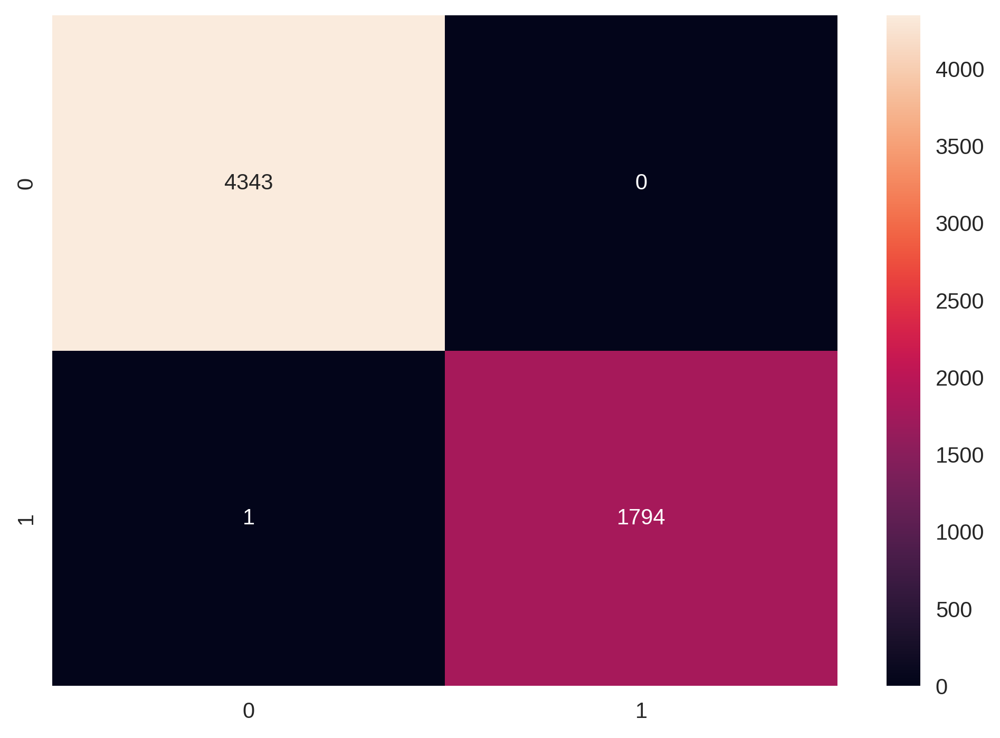

In [60]:
evaulate_model(acc_randomForest, precision_randomForest, recall_randomForest, final_RF_classifier, x_test_feature, y_test_feature)

Observation: Same accuracy as training with all the features

### 3. Gradient Boosting 

 **Gradient Boosting Classifier with Nested KFold**

In [158]:
from sklearn.ensemble import GradientBoostingClassifier

param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'min_samples_leaf': [1, 2, 4],
    'subsample': [0.8, 1.0]
}

GB_Boosting = GradientBoostingClassifier(random_state=100)

accuracy_list, precision_list, recall_list, gb_final_model, x_test_normalised, y_test = nested_kfold_validation(GB_Boosting,param_grid,X,y) 
print('Gradient Boosting best model parameters :' , gb_final_model)

Gradient Boosting best model parameters : GradientBoostingClassifier(learning_rate=0.2, min_samples_leaf=2,
                           n_estimators=200, random_state=100, subsample=0.8)


Accuracy for each fold : [0.9900635282619319, 0.9871293580971, 0.9864776800260672, 0.9903877484522646, 0.9884327142391659]
Precision for each fold : [0.9970414201183432, 0.9956361966008268, 0.9945054945054945, 0.9951501154734411, 0.9953617810760668]
Recall for each fold : [0.9891623391284714, 0.9863481228668942, 0.9866000454235748, 0.9912583390844261, 0.9882569652314068]
Average Accuracy: 0.988 (0.002)
Average Precision: 0.996 (0.001)
Average Recall: 0.988 (0.002)
Confusion Matrix


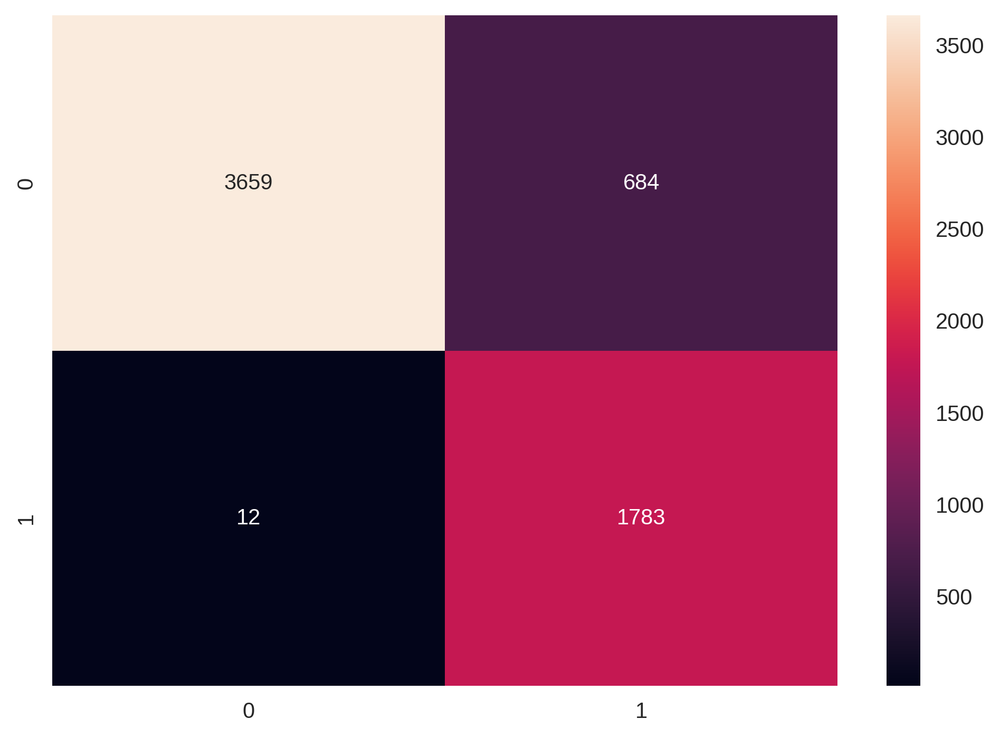

In [159]:
evaulate_model(accuracy_list, precision_list, recall_list, gb_final_model, x_test_normalised, y_test)

#### Find important features with Gradient Bossting model

In [160]:
feature_scores_GB = pd.Series(gb_final_model.feature_importances_, index=X.columns).sort_values(ascending=False)
print(feature_scores_GB)

Direct Bilirubin                        0.169951
Alkphos Alkaline Phosphotase            0.166655
Sgpt Alamine Aminotransferase           0.161267
Total Bilirubin                         0.116007
Sgot Aspartate Aminotransferase         0.115855
A/G Ratio Albumin and Globulin Ratio    0.093314
ALB Albumin                             0.086596
Total Protiens                          0.085456
Gender of the patient                   0.004217
Age of the patient                      0.000682
dtype: float64


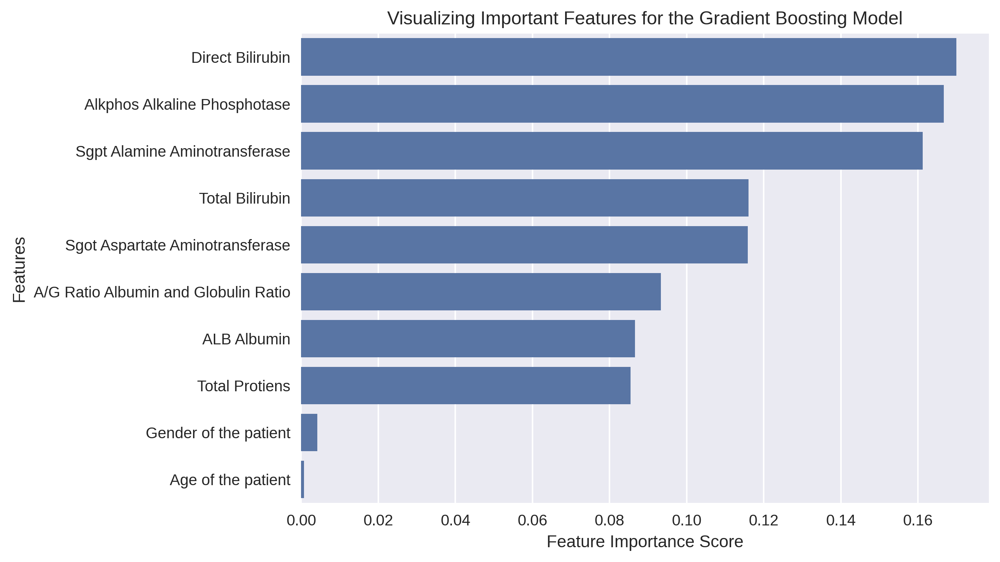

In [161]:
# Creating a bar plot
sns.barplot(x=feature_scores_GB, y=feature_scores_GB.index)

# Add labels to your graph
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')
plt.title("Visualizing Important Features for the Gradient Boosting Model")
plt.show()

Interpretation: The above plot confirms that the most important feature is "Alkphos Alkaline Phosphotase" and the least important features are "Age of the patient", and "Gender of the patient".

**Therefore, the model will be trained and evalaute with only important features.**

In [162]:
#copy initial features and result to a new variable and drop it from the dataframe
x_newData_GB = X.copy()
y_newData_GB = y.copy()
X_important_features_GB = x_newData_GB.drop(['Gender of the patient','Age of the patient'], axis=1)

**Trained the model with important features**

In [163]:
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'min_samples_leaf': [1, 2, 4],
    'subsample': [0.8, 1.0]
}

GB_topfeatures_model = GradientBoostingClassifier(random_state=100)

acc_gb, precision_gb, recall_gb, gb_feature_model, x_test_normalised, y_test = nested_kfold_validation(GB_topfeatures_model,param_grid,X_important_features_GB,y_newData_GB) 

In [164]:
print('Gradient boosting best model with important features:' , gb_feature_model)

Gradient boosting best model with important features: GradientBoostingClassifier(learning_rate=0.2, min_samples_leaf=2,
                           n_estimators=200, random_state=100)


Accuracy for each fold : [0.9895748493239941, 0.989247311827957, 0.9908765070055393, 0.9889214727924406, 0.9905506679700228]
Precision for each fold : [0.996813111768723, 0.9965588437715073, 0.9958932238193019, 0.9965189139011371, 0.996984458362329]
Recall for each fold : [0.9887107699254911, 0.9883959044368601, 0.9913695207812855, 0.9878076834598574, 0.9896384987335943]
Average Accuracy: 0.990 (0.001)
Average Precision: 0.997 (0.000)
Average Recall: 0.989 (0.001)
Confusion Matrix


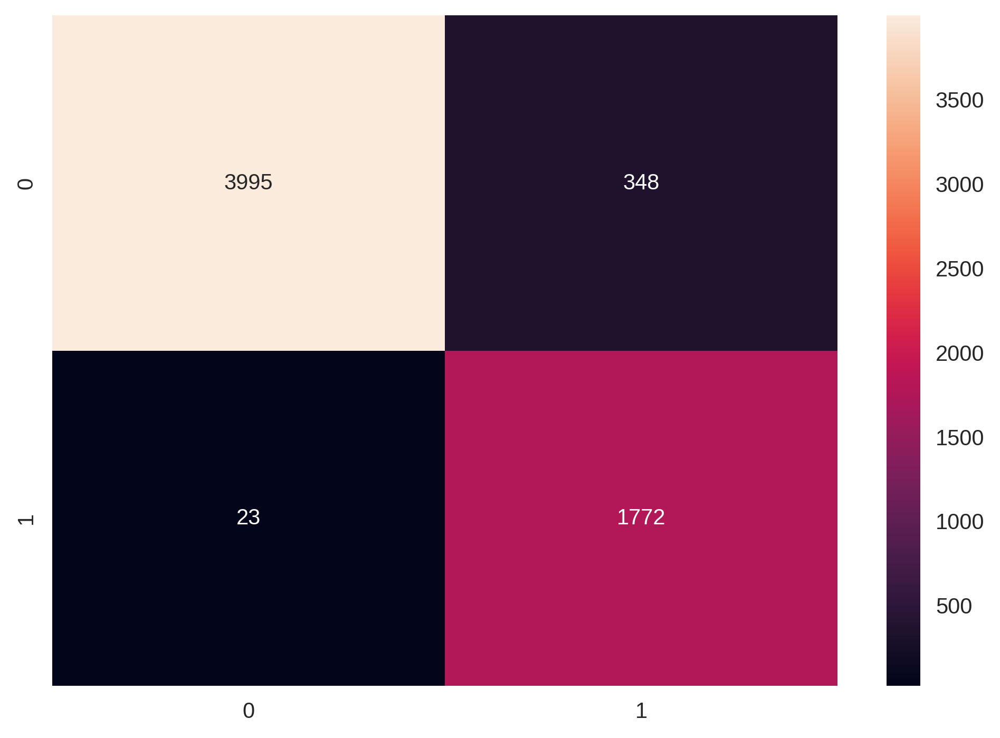

In [165]:
evaulate_model(acc_gb, precision_gb, recall_gb, gb_feature_model, x_test_normalised, y_test)

Observation: We can see a improvement when trained with important features

In [166]:
# save the gradient boosting model to disk as it take lots of time to train
gb_model_filename = 'finalized_GB_model.sav'
pickle.dump(gb_feature_model, open(gb_model_filename, 'wb'))

**ROC Curve and AUC for Gradient Boosting**

Area under curve (AUC):  0.9942595166428607


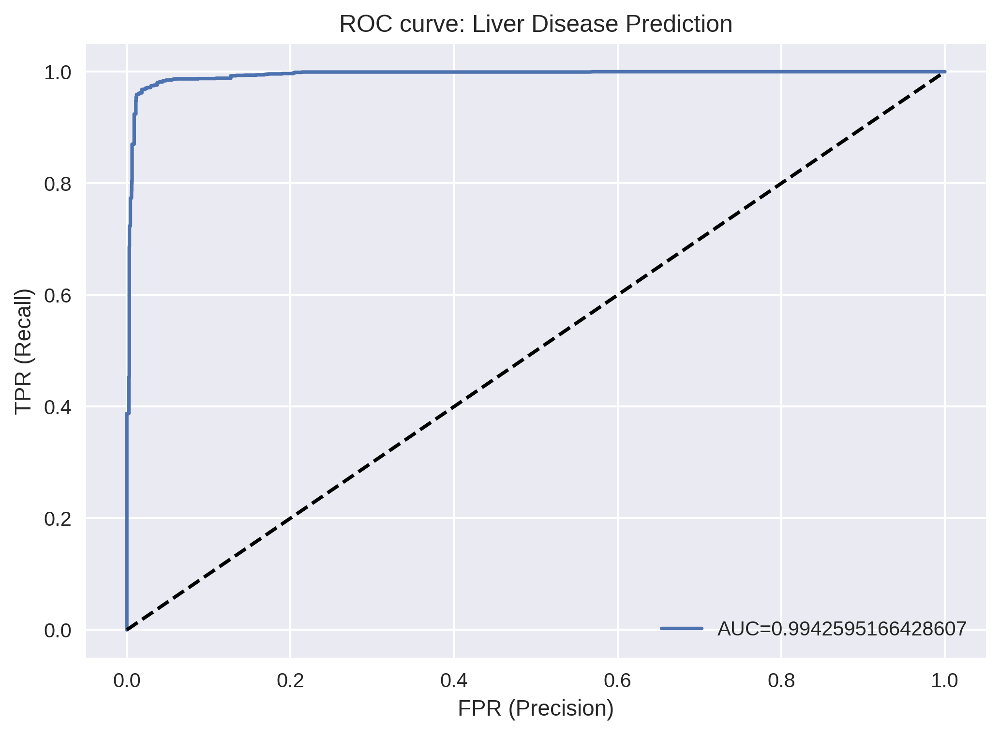

In [167]:
# roc curve for KNN final model
draw_ROC_curve(gb_feature_model,x_test_normalised, y_test)

**Predict using Gradient Boosting**

GradientBoostingClassifier(learning_rate=0.2, min_samples_leaf=2,
                           n_estimators=200, random_state=100)
Accuracy for test dataset 0.9395509499136442
Precision for test dataset 0.9973753280839895
Recall for test dataset 0.9178743961352657


<Axes: >

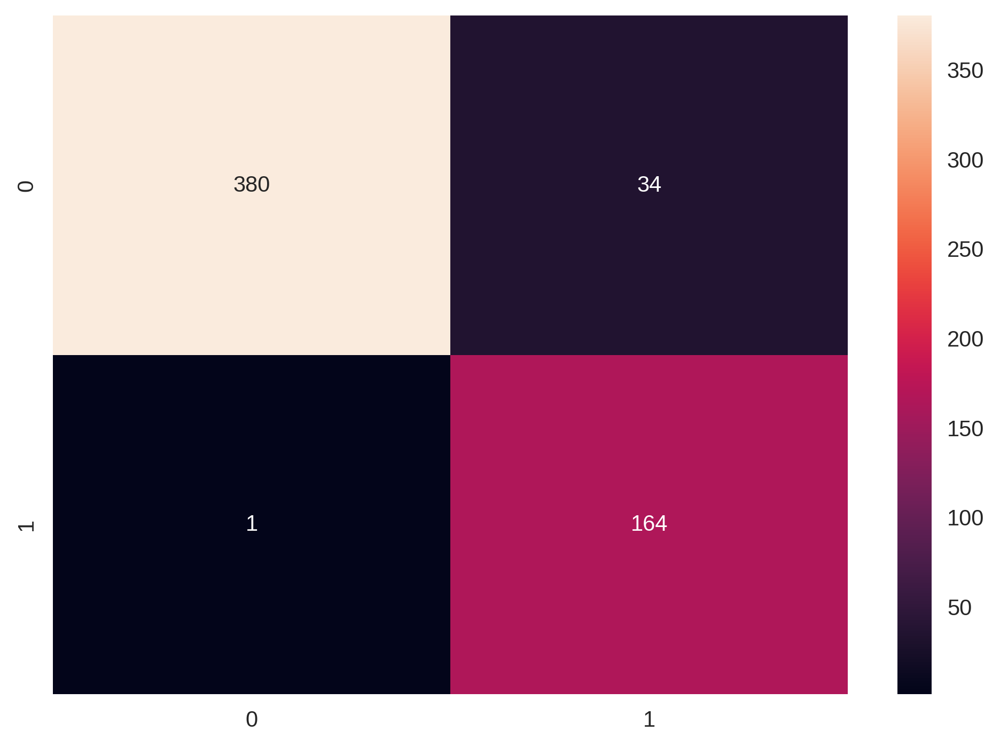

In [168]:
load_gb_filename = 'finalized_GB_model.sav'

loaded_gb_model = pickle.load(open(load_gb_filename, 'rb'))
print(loaded_gb_model)

rf_features = df_test.copy()
gB_important_features = rf_features.drop(['Gender of the patient','Age of the patient','Result'], axis=1)
xfeature_normalised = stdScalar.transform(gB_important_features)

pred_test_GB = loaded_gb_model.predict(xfeature_normalised)

print('Accuracy for test dataset',accuracy_score(y_target, pred_test_GB))
print('Precision for test dataset',precision_score(y_target, pred_test_GB))
print('Recall for test dataset',recall_score(y_target, pred_test_GB))

matrix_GB = confusion_matrix(y_target, pred_test_GB)
sns.heatmap(matrix_GB,annot = True, fmt = "d")  

### 4. Logistic Regression

In [47]:
from sklearn.linear_model import LogisticRegression

param_grid = {
    'solver' : ['newton-cg', 'lbfgs', 'liblinear'],
    'penalty' : ['l2'],
     'C' : [100, 10, 1.0, 0.1, 0.01]
}

logreg_model = LogisticRegression()

accuracy_LR, precision_LR, recall_LR, log_reg_model, x_test_normalised, y_test = nested_kfold_validation(logreg_model,param_grid,X,y) 
print('Logistic Regression model with best parameters: ',log_reg_model)

Logistic Regression model with best parameters:  LogisticRegression(C=0.1, solver='newton-cg')


Accuracy for each fold : [0.647010913829614, 0.6510263929618768, 0.642554578038449, 0.6500488758553274, 0.6469534050179212]
Precision for each fold : [0.9027777777777778, 0.8901974367855906, 0.8879522304179839, 0.8933810375670841, 0.8880171184022825]
Recall for each fold : [0.5723639647776022, 0.5847554038680318, 0.5741539859186918, 0.5744191396365309, 0.5733364034077827]
Average Accuracy: 0.648 (0.003)
Average Precision: 0.892 (0.006)
Average Recall: 0.576 (0.005)
Confusion Matrix


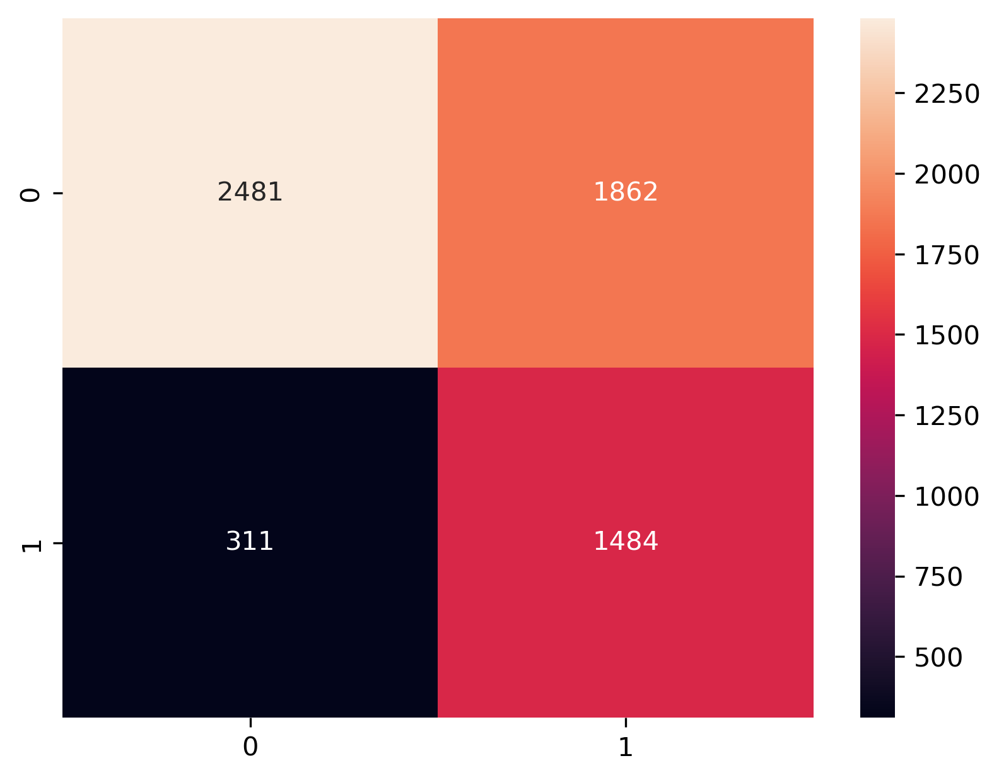

In [48]:
evaulate_model(accuracy_LR, precision_LR, recall_LR, log_reg_model, x_test_normalised, y_test)

In [49]:
import pickle

# save the svm model to disk as it take lots of time to train
filename = 'finalized_LR_model.sav'
pickle.dump(log_reg_model, open(filename, 'wb'))

**ROC Curve and AUC for Logistic Regression**

Area under curve (AUC):  0.7518958885588631


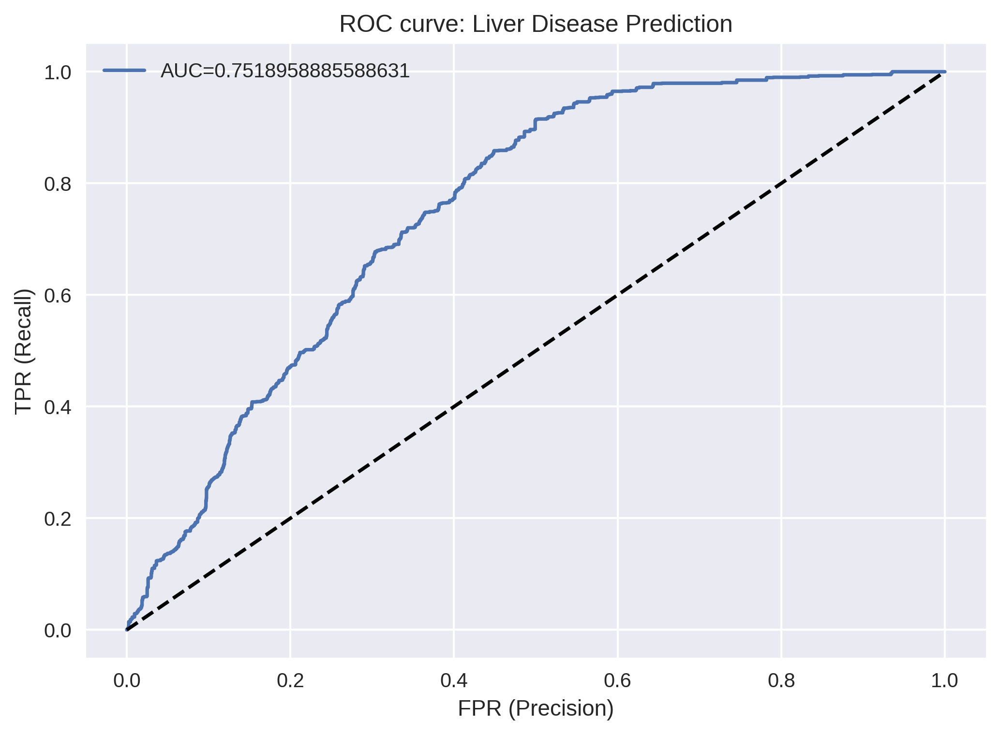

In [50]:
draw_ROC_curve(log_reg_model, x_test_normalised, y_test)

**Predicting using Logistic Regression**

LogisticRegression(C=0.1, solver='newton-cg')
Accuracy for test dataset 0.6373056994818653
Precision for test dataset 0.8953488372093024
Recall for test dataset 0.5579710144927537


<Axes: >

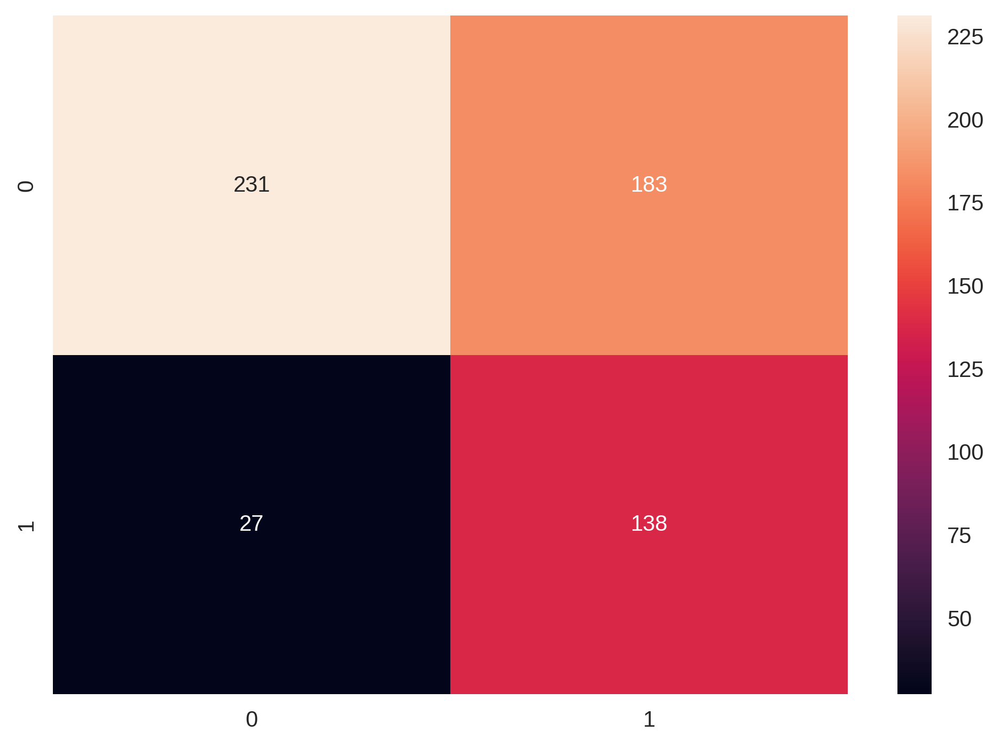

In [51]:
test_normalised = stdScalar.transform(x_features)

load_LR_file = 'finalized_LR_model.sav'

loaded_lr_model = pickle.load(open(load_LR_file, 'rb'))
print(loaded_lr_model) 

pred_test_lr = loaded_lr_model.predict(test_normalised)

print('Accuracy for test dataset',accuracy_score(y_target, pred_test_lr))
print('Precision for test dataset',precision_score(y_target, pred_test_lr))
print('Recall for test dataset',recall_score(y_target, pred_test_lr))

matrix_lr = confusion_matrix(y_target, pred_test_lr)
sns.heatmap(matrix_lr,annot = True, fmt = "d")

### 5. SVM

**SVM Classifier with Nested KFold**

In [53]:
from sklearn import svm

param_grid = {
    'kernel': ['linear','rbf','sigmoid'],
    'C': [0.1, 1, 10, 100]
}

supportVectorClassModel = svm.SVC(random_state = 7,probability=True)

accuracy_list, precision_list, recall_list, svm_model, x_test_normalised, y_test = nested_kfold_validation(supportVectorClassModel,param_grid,X,y) 
print('SVM model with best parameters: ',svm_model)

SVM model with best parameters:  SVC(C=100, probability=True, random_state=7)


Accuracy for each fold : [0.8674051148395504, 0.8721081785597915, 0.8737373737373737, 0.8734115347018573, 0.8701531443466928]
Precision for each fold : [0.9800796812749004, 0.9818473037907101, 0.9793868921775899, 0.9798387096774194, 0.983633387888707]
Recall for each fold : [0.8331451794987582, 0.8368600682593856, 0.8416988416988417, 0.8385093167701864, 0.8303016348146443]
Average Accuracy: 0.871 (0.002)
Average Precision: 0.981 (0.002)
Average Recall: 0.836 (0.004)
Confusion Matrix


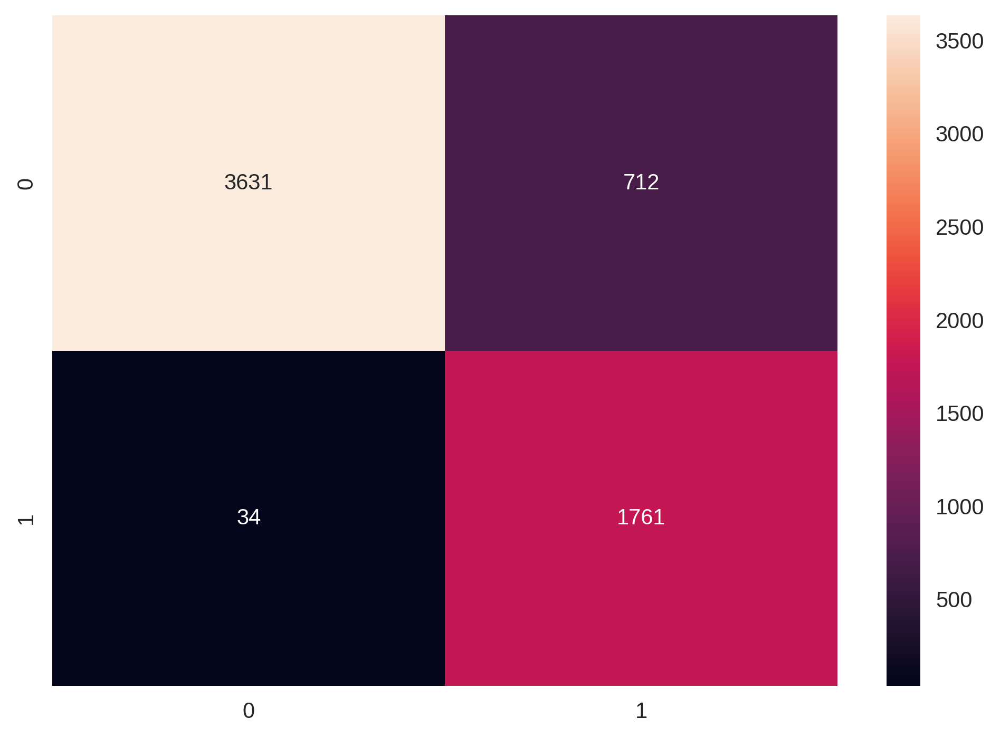

In [54]:
evaulate_model(accuracy_list, precision_list, recall_list, svm_model, x_test_normalised, y_test)

**ROC Curve and AUC for SVM**

Area under curve (AUC):  0.9549641243841944


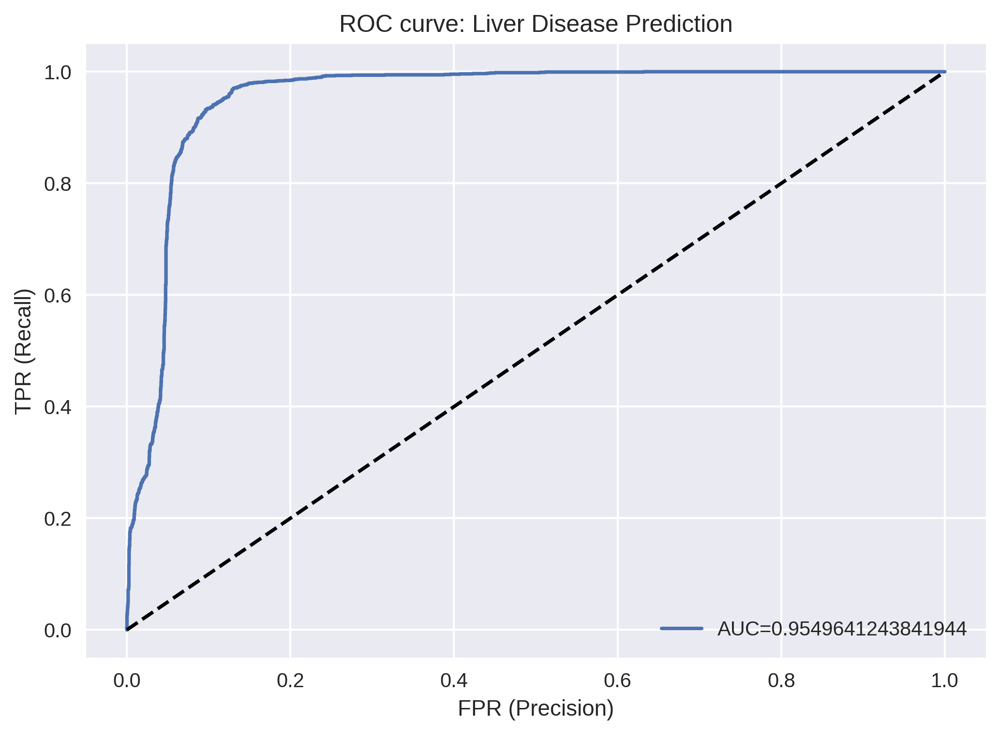

In [55]:
draw_ROC_curve(svm_model, x_test_normalised, y_test)

In [56]:
import pickle

# save the svm model to disk as it take lots of time to train
filename = 'finalized_SVM_model.sav'
pickle.dump(svm_model, open(filename, 'wb'))

**Predict using SVM** 

SVC(C=100, probability=True, random_state=7)
Accuracy for test dataset 0.8808290155440415
Precision for test dataset 0.994269340974212
Recall for test dataset 0.8381642512077294


<Axes: >

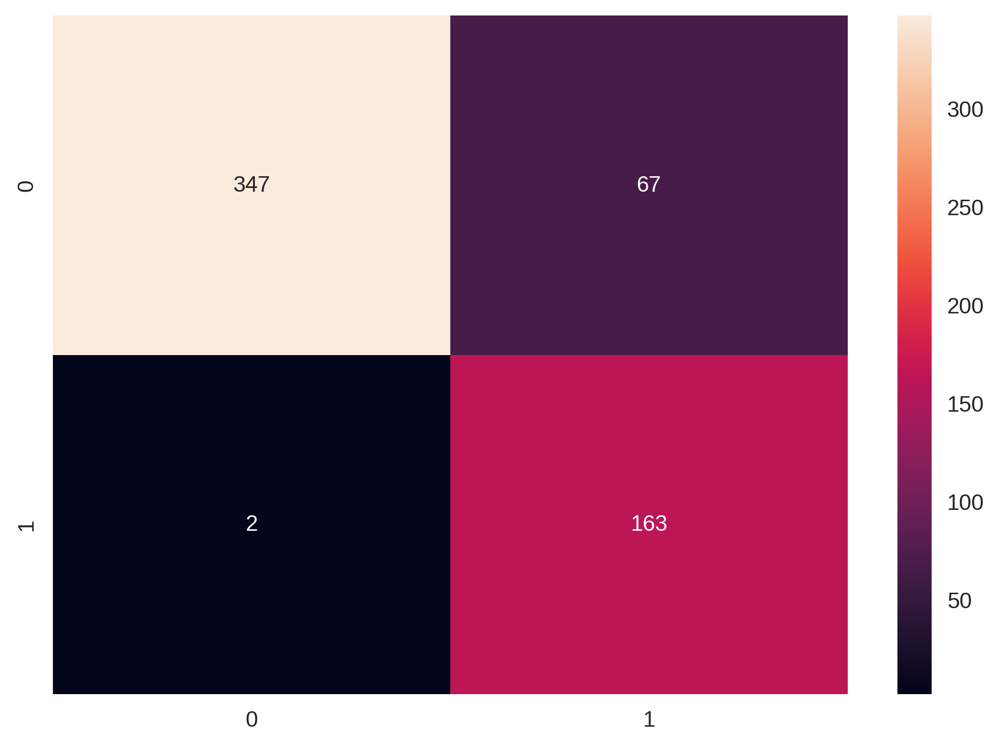

In [143]:
test_normalised = stdScalar.transform(x_features)

load_svm_file = 'finalized_SVM_model.sav'

loaded_svm_model = pickle.load(open(load_svm_file, 'rb'))
print(loaded_svm_model) 

pred_test_svm = loaded_svm_model.predict(test_normalised)

print('Accuracy for test dataset',accuracy_score(y_target, pred_test_svm))
print('Precision for test dataset',precision_score(y_target, pred_test_svm))
print('Recall for test dataset',recall_score(y_target, pred_test_svm))

matrix_svm = confusion_matrix(y_target, pred_test_svm)
sns.heatmap(matrix_svm,annot = True, fmt = "d")

### 6. Artificial Neural Network

**Create Model**

In [145]:
def create_ANN_model_with_many_hidden_layers(dropout_rate):
    # Create Model
    model = Sequential()
    
    model.add(Dense(10, input_dim = X.shape[1], activation = 'relu'))
    model.add(Dense(8, activation = 'relu'))
    model.add(Dense(4, activation = 'relu'))
    model.add(Dropout(dropout_rate))
    model.add(Dense(1, activation = 'sigmoid'))

    return model

In [109]:
# Create a KerasClassifier based on the defined modelwith many hidden layers
model_many_hidden_layer = KerasClassifier(model=create_ANN_model_with_many_hidden_layers, loss='binary_crossentropy', optimizer='adam',epochs=20,verbose=0)

# Define the grid search parameters
learn_rate = [0.001, 0.01, 0.1, 0.2, 0.3]
dropout_rate = [0.1, 0.2, 0.3, 0.4, 0.5]

ann_param_grid = dict(optimizer__learning_rate=learn_rate,model__dropout_rate=dropout_rate)


**Training ANN with nested k-fold validation**

In [110]:
ann_best_score = -np.inf
ann_accuracy_list = []
ann_precision_list = []
ann_recall_list = []
ann_true_label = []
ann_final_model = None

k=4
cv_outer = KFold(n_splits=k, random_state=42, shuffle=True)
for train_index, test_index in cv_outer.split(X):

    X_train, X_test = X.iloc[train_index, :], X.iloc[test_index, :]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    # fit the object to our training data
    x_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)
    
    # data normalisation
    x_train_normalised = stdScalar.fit_transform(x_train_smote)
    x_test_normalised = stdScalar.transform(X_test)
    
    cv_inner = KFold(n_splits=2, random_state=42, shuffle=True)
    
    # Create the GridSearchCV object
    grid_search = GridSearchCV(estimator=model_many_hidden_layer, param_grid=ann_param_grid, cv=cv_inner, scoring='accuracy', return_train_score=True)

    # Fit the model to the data
    result = grid_search.fit(x_train_normalised, y_train_smote)
    
    best_model = result.best_estimator_
    print("Best Parameters: ", result.best_params_)
    
    predicted_labels = best_model.predict(x_test_normalised)
    print('pred_values - {}'.format(predicted_labels))
    
    # evaluate the model
    acc = accuracy_score(y_test, predicted_labels)
    ann_accuracy_list.append(acc)
    
    precision = precision_score(y_test, predicted_labels)
    ann_precision_list.append(precision)
    
    recall = recall_score(y_test, predicted_labels)
    ann_recall_list.append(recall)
    
    # Update the best model and best score if the current model performs better
    if acc > ann_best_score:
        ann_best_score = acc
        ann_final_model = best_model

Best Parameters:  {'model__dropout_rate': 0.1, 'optimizer__learning_rate': 0.01}
pred_values - [2 2 2 ... 2 1 1]
Best Parameters:  {'model__dropout_rate': 0.1, 'optimizer__learning_rate': 0.01}
pred_values - [2 1 1 ... 2 1 1]
Best Parameters:  {'model__dropout_rate': 0.2, 'optimizer__learning_rate': 0.01}
pred_values - [1 1 2 ... 2 1 1]
Best Parameters:  {'model__dropout_rate': 0.1, 'optimizer__learning_rate': 0.01}
pred_values - [2 1 2 ... 1 1 1]


KerasClassifier(
	model=<function create_ANN_model_with_many_hidden_layers at 0xfffeccea8ea0>
	build_fn=None
	warm_start=False
	random_state=None
	optimizer=adam
	loss=binary_crossentropy
	metrics=None
	batch_size=None
	validation_batch_size=None
	verbose=0
	callbacks=None
	validation_split=0.0
	shuffle=True
	run_eagerly=False
	epochs=20
	class_weight=None
	model__dropout_rate=0.1
	optimizer__learning_rate=0.01
)
Accuracy for each fold : [0.7839176332594813, 0.7853512315912942, 0.7489899648116773, 0.7165015641293013]
Precision for each fold : [0.9879154078549849, 0.9695715676728335, 0.9859697386519944, 0.9888487040385775]
Recall for each fold : [0.7090711962414167, 0.7235240690281562, 0.6565305000915919, 0.6054622624100388]
Average Accuracy: 0.759 (0.028)
Average Precision: 0.983 (0.008)
Average Recall: 0.674 (0.047)
Confusion Matrix


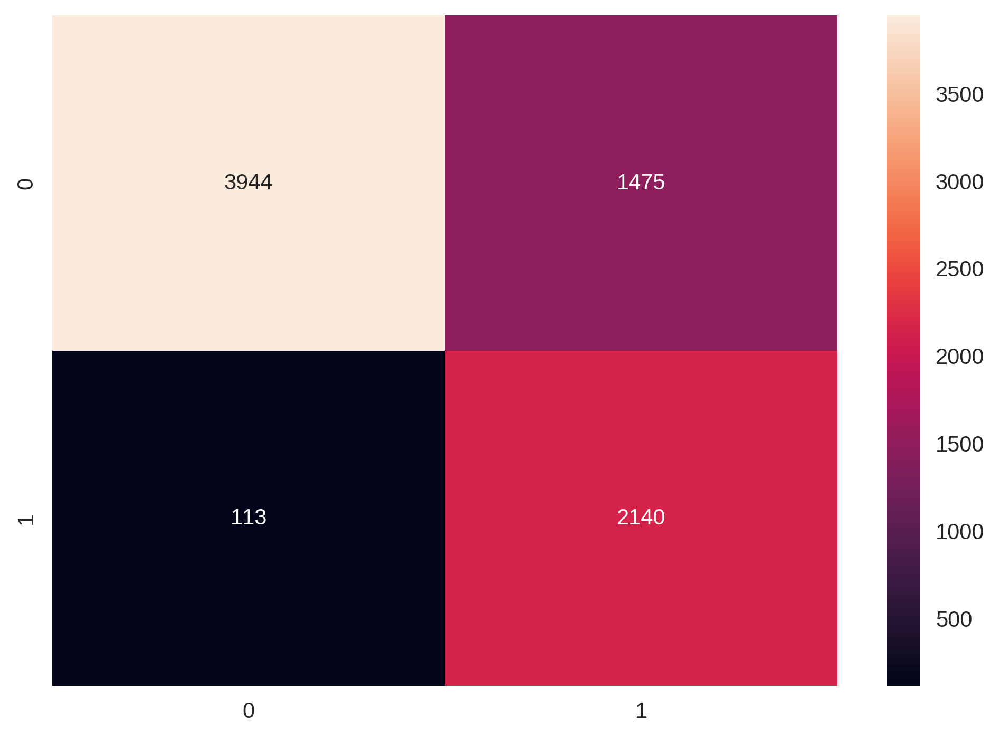

In [111]:
print(ann_final_model)
evaulate_model(ann_accuracy_list, ann_precision_list, ann_recall_list, ann_final_model, x_test_normalised, y_test)

In [112]:
# save the ANN model to disk as it take lots of time to train
ann_filename = 'ANN_model_many_hidden.sav'
pickle.dump(ann_final_model, open(ann_filename, 'wb'))

INFO:tensorflow:Assets written to: ram://c2b80078858d490da10e909b3c3a44f5/assets


INFO:tensorflow:Assets written to: ram://c2b80078858d490da10e909b3c3a44f5/assets


**ROC Curve and AUC for ANN**

Area under curve (AUC):  0.9238761596254306


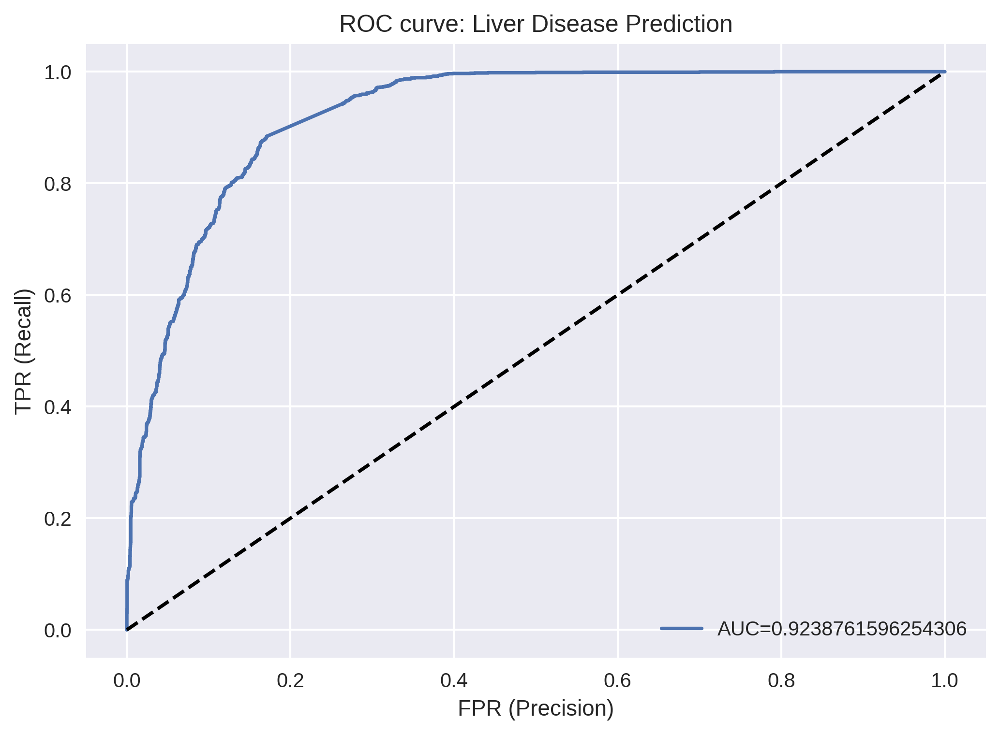

In [113]:
# roc curve for KNN final model
draw_ROC_curve(ann_final_model,x_test_normalised, y_test)

**Predicting using ANN**

2024-05-06 14:26:39.157251: W tensorflow/core/util/tensor_slice_reader.cc:97] Could not open ram://ed6ac35ac1f64c1eb164cd6f162ff85d: INVALID_ARGUMENT: ram://ed6ac35ac1f64c1eb164cd6f162ff85d is a directory.


KerasClassifier(
	model=<function create_ANN_model_with_many_hidden_layers at 0xffff19b83560>
	build_fn=None
	warm_start=False
	random_state=None
	optimizer=adam
	loss=binary_crossentropy
	metrics=None
	batch_size=None
	validation_batch_size=None
	verbose=0
	callbacks=None
	validation_split=0.0
	shuffle=True
	run_eagerly=False
	epochs=20
	class_weight=None
	model__dropout_rate=0.1
	optimizer__learning_rate=0.01
)
Accuracy for test dataset 0.7841105354058722
Precision for test dataset 0.9832775919732442
Recall for test dataset 0.7101449275362319


<Axes: >

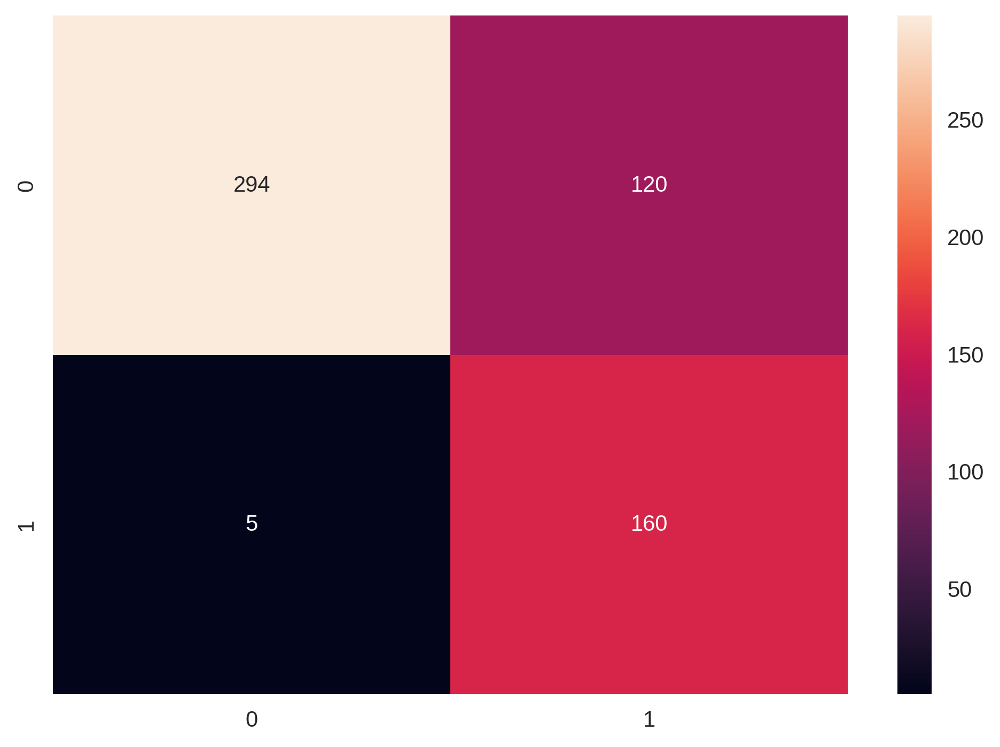

In [146]:
test_normalised = stdScalar.transform(x_features)

load_ann_file = 'ANN_model_many_hidden.sav'

loaded_ann_model = pickle.load(open(load_ann_file, 'rb'))
print(loaded_ann_model)

pred_test_ann = loaded_ann_model.predict(test_normalised)

print('Accuracy for test dataset',accuracy_score(y_target, pred_test_ann))
print('Precision for test dataset',precision_score(y_target, pred_test_ann))
print('Recall for test dataset',recall_score(y_target, pred_test_ann))

matrix_ann = confusion_matrix(y_target, pred_test_ann)
sns.heatmap(matrix_ann,annot = True, fmt = "d")

# 6. Analyse the Model Output with SHAP (SHapley Additive exPlanations)

In [53]:
#Install SHAP module
!pip install shap

In [54]:
import shap

# Fits the explainer
explainer = shap.Explainer(loaded_knn_model.predict,test_normalised)
# Calculates the SHAP values - It takes some time
shap_values = explainer(test_normalised)

ExactExplainer explainer: 580it [49:44,  5.16s/it]                         


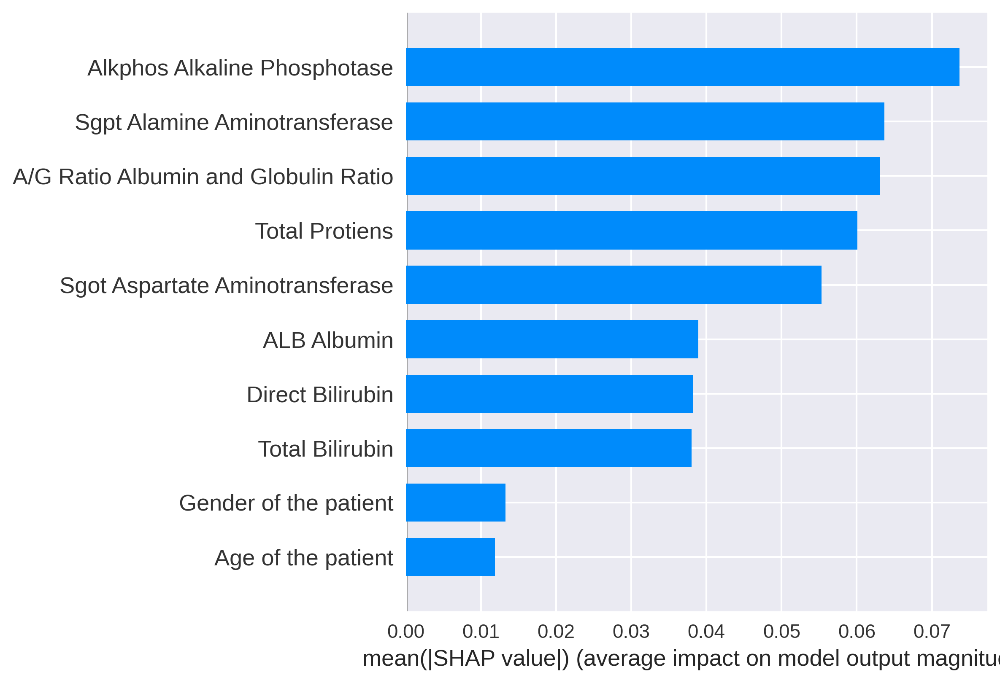

In [136]:
shap.summary_plot(shap_values, test_normalised, plot_type="bar", feature_names=x_features.keys())

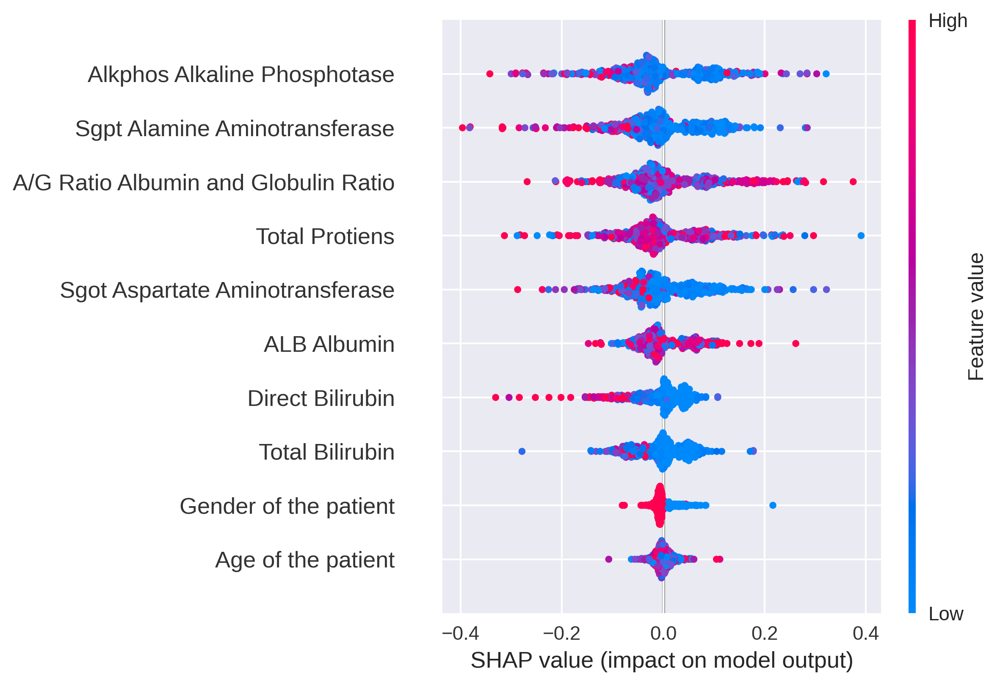

In [137]:
shap.summary_plot(shap_values, test_normalised, feature_names=x_features.keys())